In [25]:
import anndata
import pixelator
import torch
import scvi
import scipy
# from scvi import autotune

import seaborn as sns
import scanpy as sc
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from tqdm import tqdm

from scib_metrics.benchmark import Benchmarker, BioConservation, BatchCorrection

# import ray
# from ray import tune


from PixelGen.pxl_utils import *
from PixelGen.scvi_utils import plot_losses
from PixelGen.tests import test_convert_edgelist_to_protein_pair_colocalization

from pixelator.plot import molecule_rank_plot, cell_count_plot, scatter_umi_per_upia_vs_tau
from pixelator.statistics import clr_transformation
from pixelator.analysis.normalization import dsb_normalize


import tempfile

from scvi import REGISTRY_KEYS
from scvi.module.base import (
    BaseModuleClass,
    LossOutput,
    PyroBaseModuleClass,
    auto_move_data,
)
from torch.distributions import NegativeBinomial, Normal, Poisson
from torch.distributions import kl_divergence as kl

from PixelGen.modules import NormalVAE, NormalSCVI
from cytovi import CytoVI

print(torch.cuda.is_available())

%load_ext autoreload
%autoreload 2

scvi.settings.seed = 0
print("Last run with scvi-tools version:", scvi.__version__)
sc.set_figure_params(figsize=(6, 6), frameon=False)
sns.set_theme()
torch.set_float32_matmul_precision("high")
save_dir = tempfile.TemporaryDirectory()

%config InlineBackend.print_figure_kwargs={"facecolor": "w"}
%config InlineBackend.figure_format="retina"

Seed set to 0


True
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Last run with scvi-tools version: 1.2.2.post2


In [126]:
DATA_DIR = Path('./PixelGen/datasets')


FILENAMES = [
    "Sample07_pbmc_CD3_capped.layout.dataset.pxl",
    "Sample08_pbmc_CD3_capped.layout.dataset.pxl",
    "Sample01_human_pbmcs_unstimulated.layout.dataset.pxl",
    "Sample02_human_pbmcs_unstimulated.layout.dataset.pxl"
]


BASE_URLS = [
    "https://pixelgen-technologies-datasets.s3.eu-north-1.amazonaws.com/mpx-datasets/pixelator/0.18.x/cd3-capping-v1.0-immunology-I"
]*2 + [
    "https://pixelgen-technologies-datasets.s3.eu-north-1.amazonaws.com/mpx-datasets/pixelator/0.18.x/1k-human-pbmcs-v1.0-immunology-I"
]*2

URLS = [f'{b}/{f}' for (b,f) in zip(FILENAMES, BASE_URLS)]


SAMPLE_NAMES = [
    "treated_1", 
    "treated_2",
    "control_1",
    "control_2",
]

# COMBINED_FILENAME = "combined_resting_data.pxl"

COMBINED_FILENAME = "cd3_combined.pxl"
COMBINED_PROCESSED_NAME = "cd3_combined_PROCESSED.pxl"

combined_path = DATA_DIR / COMBINED_FILENAME
combined_processed_path = DATA_DIR / COMBINED_PROCESSED_NAME

# pg_data = pixelator.read(DATA_DIR / COMBINED_PROCESSED_NAME)
# adata = pg_data.adata

if os.path.exists(combined_processed_path):
    pg_data = pixelator.read(combined_processed_path)
else:
    for url in URLS:
        !curl -L -O -C - --create-dirs --output-dir {DATA_DIR} {url}

    datasets = [pixelator.read(DATA_DIR / filename) for filename in FILENAMES]
    pg_data = pixelator.simple_aggregate(
        SAMPLE_NAMES, datasets
    )
    # pg_data.save(combined_path, force_overwrite=True)

## Annotation and PP
Scroll down to start from the annotated data file

In [281]:
adata = pg_data.adata
adata.layers['counts'] = adata.X.copy()
adata.layers['dsb'] = dsb_normalize(adata.to_df('counts'), isotype_controls=['mIgG1', 'mIgG2a', 'mIgG2b'])
adata.layers['clr_by_cell'] = clr_transformation(adata.to_df('counts'), axis=1)
adata.layers['clr_by_ab'] = clr_transformation(adata.to_df('counts'), axis=0)
adata.layers['log1p'] = np.log1p(adata.to_df('counts'))

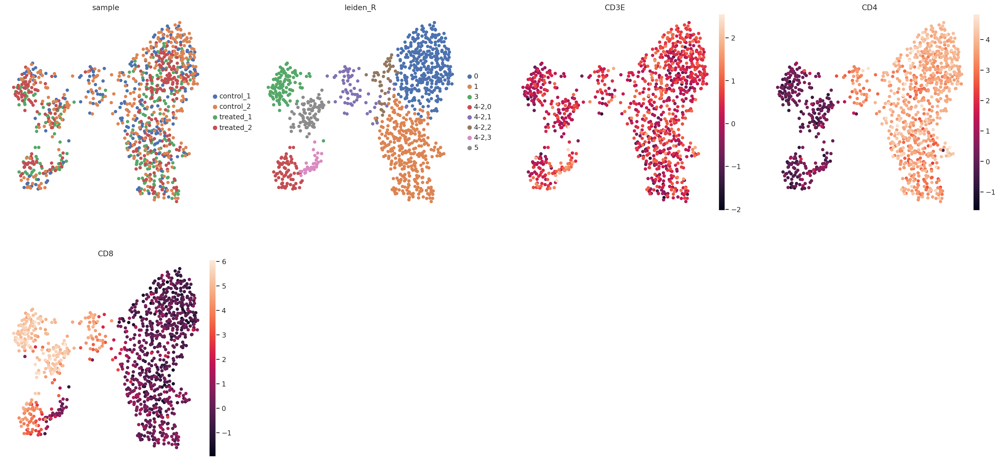

In [292]:
sc.pp.pca(adata, layer='dsb')
sc.pp.neighbors(adata)
sc.tl.umap(adata)
sc.tl.leiden(adata, resolution=0.5)
sc.tl.leiden(adata, restrict_to=('leiden', ['4', '2']), key_added='leiden_R', resolution=0.5)
sc.pl.umap(adata, layer='dsb', color=['sample', 'leiden_R', 'CD3E', 'CD4', 'CD8', ])

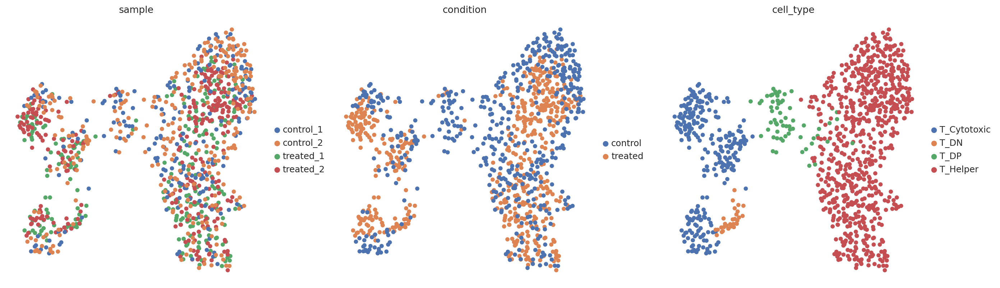

In [293]:
annot_dict_reverse = {'T_Helper': ['0','1', '4-2,2'], 'T_Cytotoxic': ['3','4-2,0', '5'], 'T_DN': ['4-2,3'], 'T_DP': ['4-2,1']}
annot_dict = {id: cell_type for (cell_type, ids) in annot_dict_reverse.items() for id in ids}
adata.obs['cell_type'] = adata.obs['leiden_R'].map(annot_dict)

sample_to_condition = {'treated_1': 'treated', 'treated_2': 'treated', 'control_1': 'control', 'control_2': 'control'}
adata.obs['condition'] = adata.obs['sample'].map(sample_to_condition)

sc.pl.umap(adata, color=['sample', 'condition', 'cell_type'])

In [425]:
polarization_i = convert_polarization_to_feature_matrix(pg_data.polarization, components=adata.obs.index, key='morans_i')
polarization_z = convert_polarization_to_feature_matrix(pg_data.polarization, components=adata.obs.index, key='morans_z')
adata.obsm['polarization_morans_i'] = polarization_i.reindex(adata.obs.index)
adata.obsm['polarization_morans_z'] = polarization_z.reindex(adata.obs.index)


In [3]:
# adata.write_h5ad('cd3_combined_annotated_with_pol.h5ad')
adata = anndata.read_h5ad('cd3_combined_annotated_with_pol.h5ad')

In [ ]:
pol_adata = anndata.AnnData(
    X=adata.obsm['polarization_morans_i'],
    obs=adata.obs
)
joint_adata = anndata.AnnData(
    X=pd.concat((adata.to_df('dsb'), adata.obsm['polarization_morans_i']), axis=1),
    obs=adata.obs
)
adata.obs['CD3E_pol'] = adata.obsm['polarization_morans_i']['CD3E_pol']
add_one_hot_encoding_obsm(adata, obs_column='cell_type')

Text(0.5, 0.98, 'Abundance (latent=PCA)')

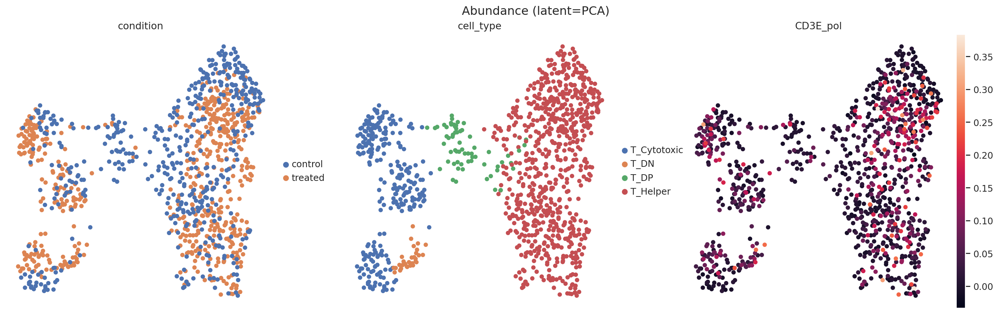

In [97]:
sc.pp.pca(adata, layer='dsb')
sc.pp.neighbors(adata, key_added='abundance_pca')
sc.tl.umap(adata, neighbors_key='abundance_pca')
sc.pl.umap(adata, layer='dsb', color=['condition', 'cell_type', 'CD3E_pol'], return_fig=True).suptitle('Abundance (latent=PCA)')

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: PossibleUserWarning:

The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.



Training:   0%|          | 0/1000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 50 records. Best score: 85.571. Signaling Trainer to stop.


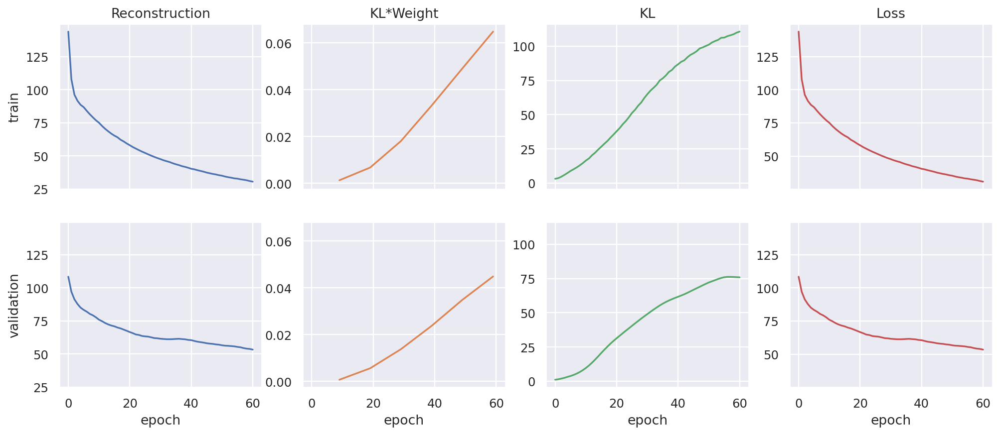

In [169]:
EPOCHS = 1000
model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=50, batch_size=2000,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(lr=5e-3, optimizer='Adam', n_epochs_kl_warmup=100000))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1,)
model_cls.setup_anndata(adata, layer='dsb', batch_key='sample',)
abundance_model = model_cls(adata, **model_kwargs)
abundance_model.train(**train_kwargs)
ax = plot_losses(abundance_model)

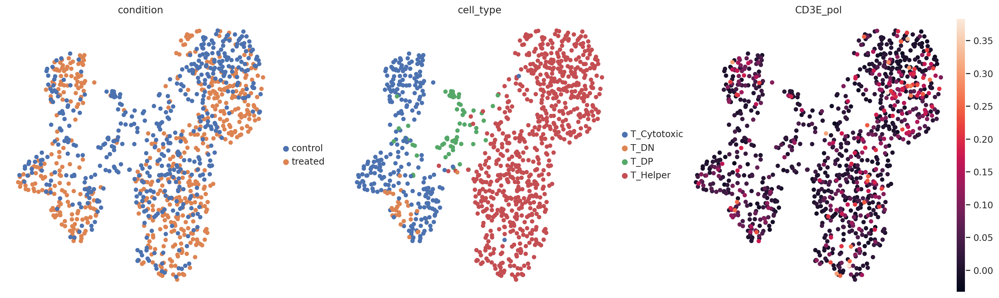

In [170]:
adata.obsm['abundance_model_latent'] = abundance_model.get_latent_representation()
sc.pp.neighbors(adata, use_rep='abundance_model_latent', key_added='abundance_model_latent')
sc.tl.umap(adata, neighbors_key='abundance_model_latent')
sc.pl.umap(adata, layer='dsb', color=['condition', 'cell_type', 'CD3E_pol'])

INFO     Generating sequential column names                                                                        


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: -155.415. Signaling Trainer to stop.


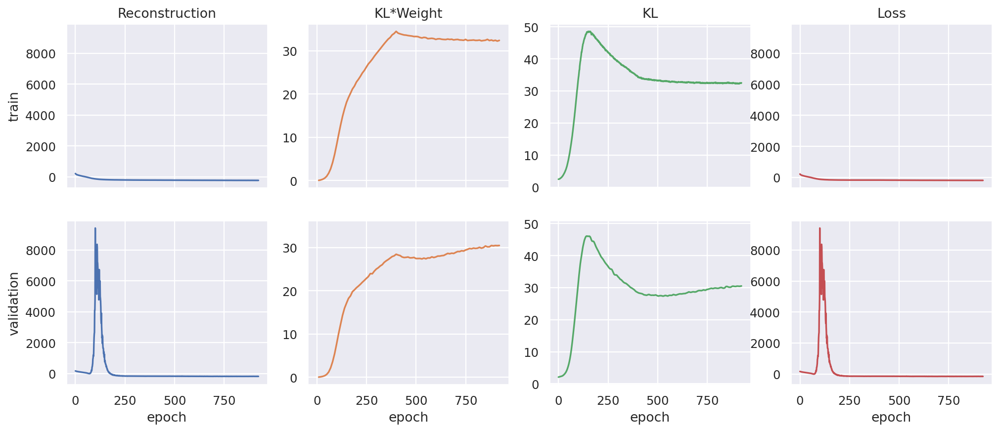

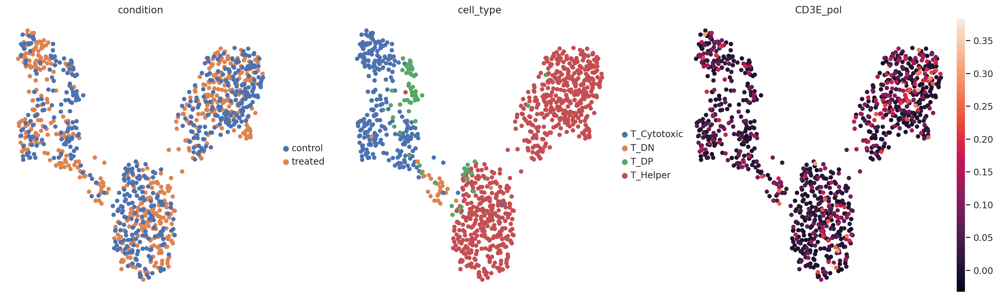

In [76]:
random_noise = np.random.default_rng(seed=0).normal(loc=0, scale=0.01, size=(len(adata.obs), 80))
adata.obsm['noise'] = random_noise
# adata.obsm['noise'] = np.zeros_like(random_noise)

EPOCHS = 10000
obsm_extra_modality_keys=['noise']

model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=2000, 
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam', n_epochs_kl_warmup=400, lr=1e-3,))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, n_extra_modalities=1, obsm_extra_modality_keys=obsm_extra_modality_keys, weights=[0.5, 0.5])
model_cls.setup_anndata(adata, layer='dsb', batch_key='sample', obsm_extra_modality_keys=obsm_extra_modality_keys)
noise_model = model_cls(adata, **model_kwargs)
# print(normal_joint_model)
noise_model.train(**train_kwargs)
ax = plot_losses(noise_model)

adata.obsm['noise_model_latent'] = noise_model.get_latent_representation()
sc.pp.neighbors(adata, use_rep='noise_model_latent', key_added='noise_model_latent')
sc.tl.umap(adata, neighbors_key='noise_model_latent')
sc.pl.umap(adata, layer='dsb', color=['condition', 'cell_type', 'CD3E_pol'])

Text(0.5, 0.98, 'Abundance')

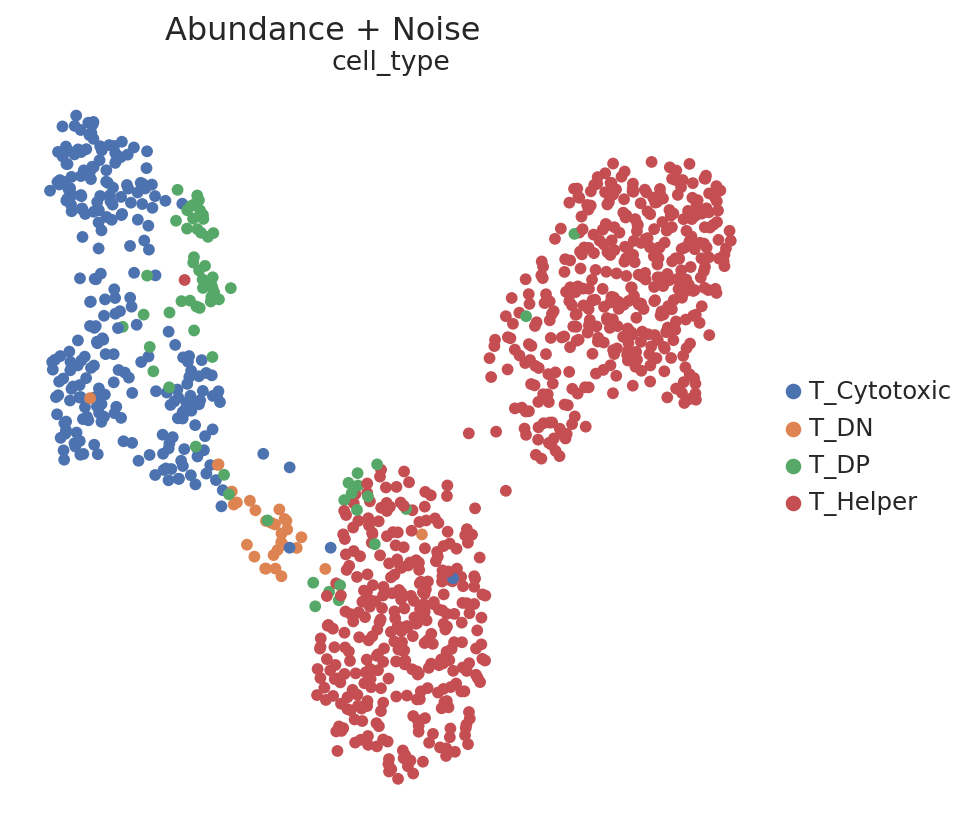

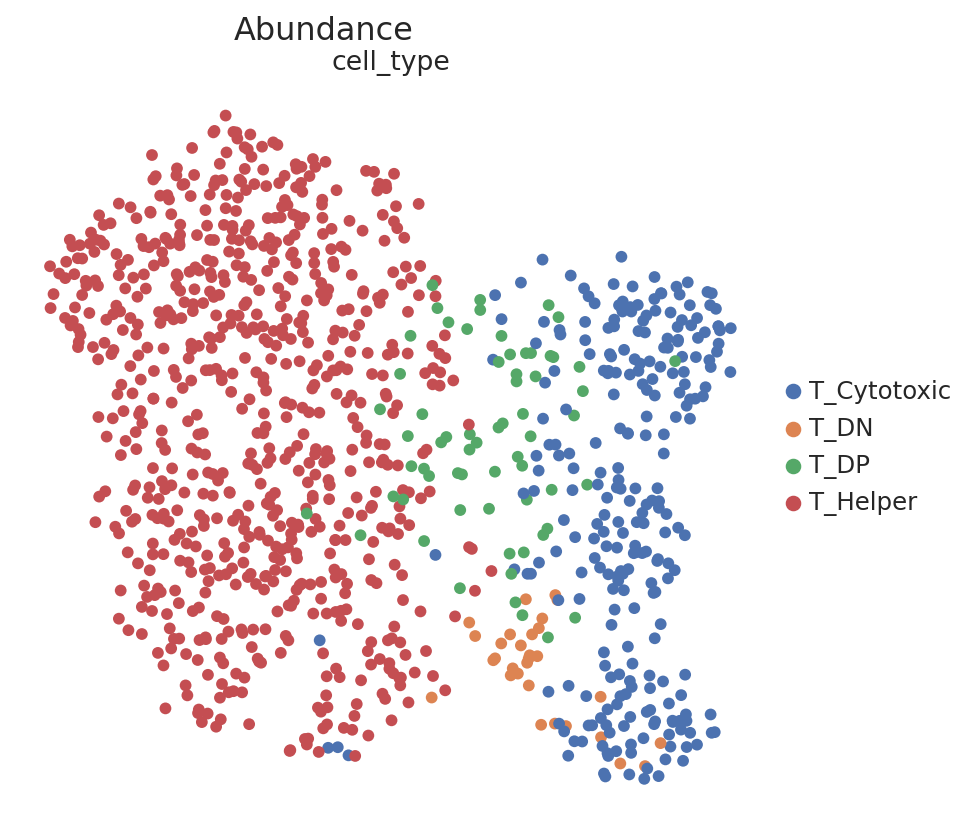

In [128]:
sc.tl.umap(adata, neighbors_key='noise_model_latent')
sc.pl.umap(adata, layer='dsb', color=['cell_type',], return_fig=True).suptitle('Abundance + Noise')

sc.tl.umap(adata, neighbors_key='abundance_model_latent')
sc.pl.umap(adata, layer='dsb', color=['cell_type',], return_fig=True).suptitle('Abundance')


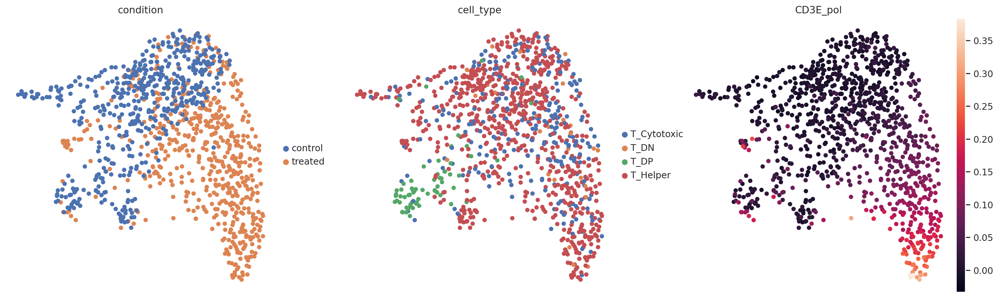

In [47]:
# joint_df = center_feature_matrix(joint_df) 

adata.obsm['concat_data'] = joint_adata.to_df()
sc.pp.pca(pol_adata)
sc.pp.neighbors(pol_adata)
sc.tl.umap(pol_adata)
sc.pl.umap(pol_adata, color=['condition', 'cell_type', 'CD3E_pol'])
# joint_adata = all_joint_adata.copy()
# sc.pp.highly_variable_genes(all_joint_adata, flavor='seurat', n_top_genes=160)
# sc.pl.highly_variable_genes(all_joint_adata)
# print(all_joint_adata.var['highly_variable']['CD3E_pol'])
# joint_adata = all_joint_adata[:, all_joint_adata.var[all_joint_adata.var['highly_variable']].index]

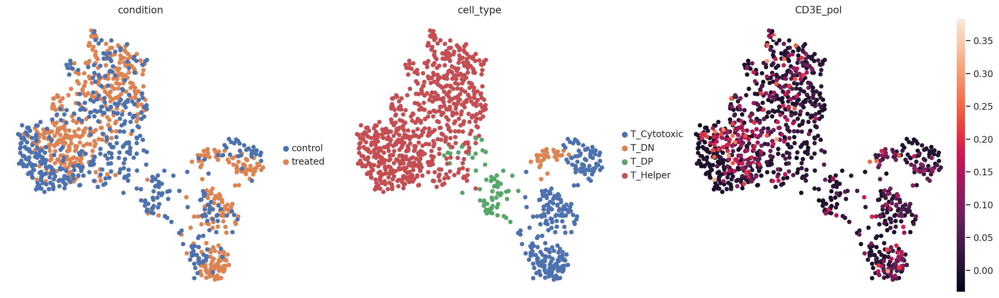

In [50]:
sc.pp.pca(joint_adata)
adata.obsm['concat_data_pca'] = joint_adata.obsm['X_pca']
sc.pp.neighbors(adata, use_rep='concat_data_pca', key_added='concat_data_pca')
sc.pp.neighbors(joint_adata)
sc.tl.umap(joint_adata)
sc.pl.umap(joint_adata, color=['condition', 'cell_type', 'CD3E_pol'])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: -250.813. Signaling Trainer to stop.


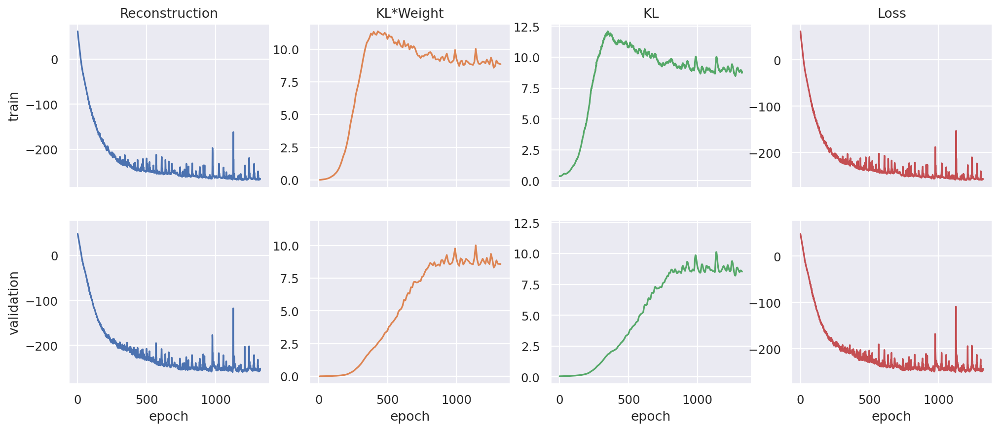

In [20]:
EPOCHS = 10000
model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=2000,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(lr=1e-3, optimizer='Adam', n_epochs_kl_warmup=400))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1,)
model_cls.setup_anndata(pol_adata, batch_key='sample',)
pol_model = model_cls(pol_adata, **model_kwargs)
pol_model.train(**train_kwargs)
ax = plot_losses(pol_model)

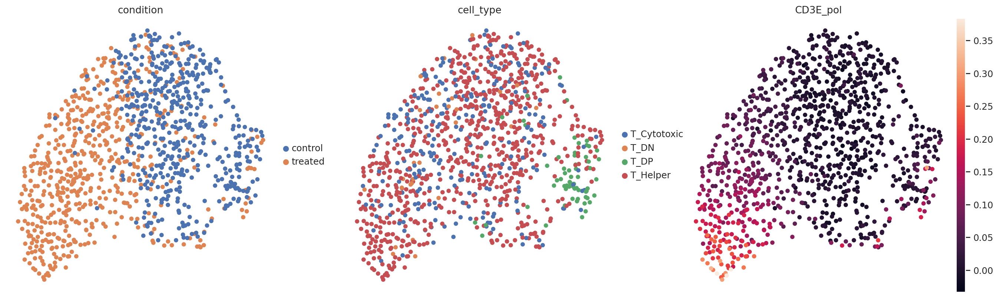

In [21]:
adata.obsm['pol_model_latent'] = pol_model.get_latent_representation()
sc.pp.neighbors(adata, use_rep='pol_model_latent', key_added='pol_model_latent')
sc.tl.umap(adata, neighbors_key='pol_model_latent')
sc.pl.umap(adata, layer='dsb', color=['condition', 'cell_type', 'CD3E_pol'])

INFO     Using column names from columns of adata.obsm['polarization_morans_i']                                    


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: -153.692. Signaling Trainer to stop.


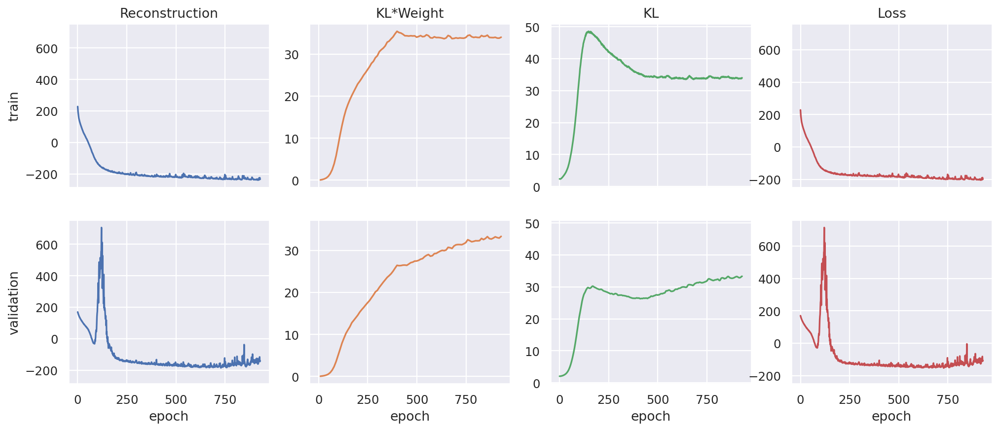

In [18]:
EPOCHS = 10000
obsm_extra_modality_keys=['polarization_morans_i']

model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=2000, 
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam', n_epochs_kl_warmup=400, lr=1e-3,))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, n_extra_modalities=1, obsm_extra_modality_keys=obsm_extra_modality_keys, weights=[0.5, 0.5])
model_cls.setup_anndata(adata, layer='dsb', batch_key='sample', obsm_extra_modality_keys=obsm_extra_modality_keys)
multi_model = model_cls(adata, **model_kwargs)
# print(normal_joint_model)
multi_model.train(**train_kwargs)
ax = plot_losses(multi_model)

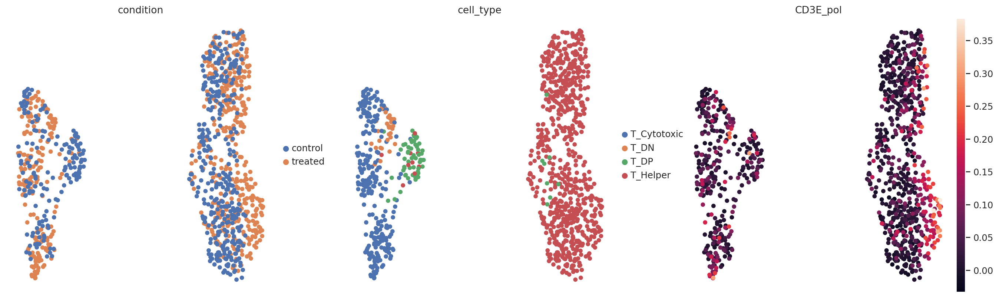

In [19]:
adata.obsm['multi_model_latent'] = multi_model.get_latent_representation()
sc.pp.neighbors(adata, use_rep='multi_model_latent', key_added='multi_model_latent')
sc.tl.umap(adata, neighbors_key='multi_model_latent')
sc.pl.umap(adata, layer='dsb', color=['condition', 'cell_type', 'CD3E_pol'])

INFO     Using column names from columns of adata.obsm['polarization_morans_i']                                    


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: -163.797. Signaling Trainer to stop.


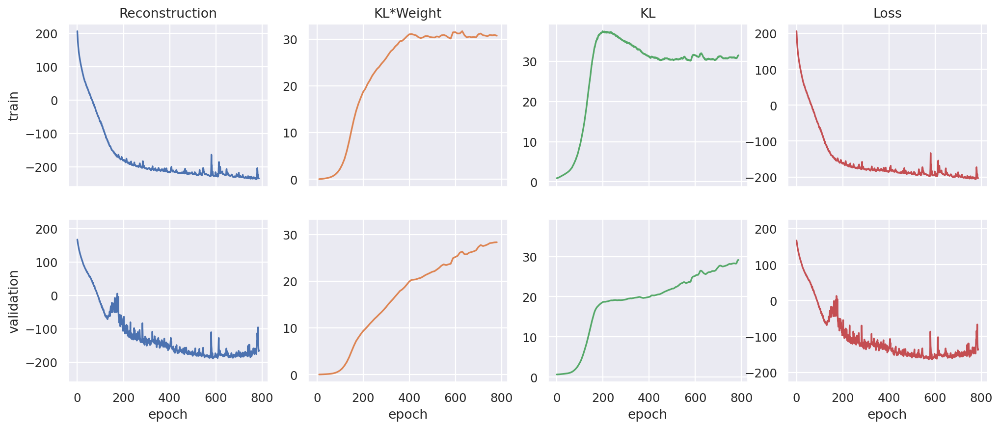

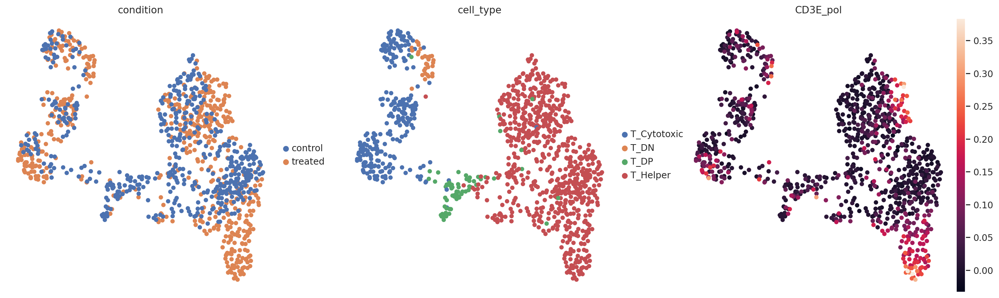

In [ ]:
EPOCHS = 10000
obsm_extra_modality_keys=['polarization_morans_i']

model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=2000, 
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam', n_epochs_kl_warmup=400, lr=1e-3,))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, n_extra_modalities=1, obsm_extra_modality_keys=obsm_extra_modality_keys, weights=[0.2, 0.8])
model_cls.setup_anndata(adata, layer='dsb', batch_key='sample', obsm_extra_modality_keys=obsm_extra_modality_keys)
multi_80_model = model_cls(adata, **model_kwargs)
# print(normal_joint_model)
multi_80_model.train(**train_kwargs)
ax = plot_losses(multi_80_model)

latent_name = 'multi_80_model_latent'

adata.obsm[latent_name] = multi_80_model.get_latent_representation()
sc.pp.neighbors(adata, use_rep=latent_name, key_added=latent_name)
sc.tl.umap(adata, neighbors_key=latent_name)
sc.pl.umap(adata, layer='dsb', color=['condition', 'cell_type', 'CD3E_pol'])

INFO     Using column names from columns of adata.obsm['polarization_morans_i']                                    


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: -172.547. Signaling Trainer to stop.


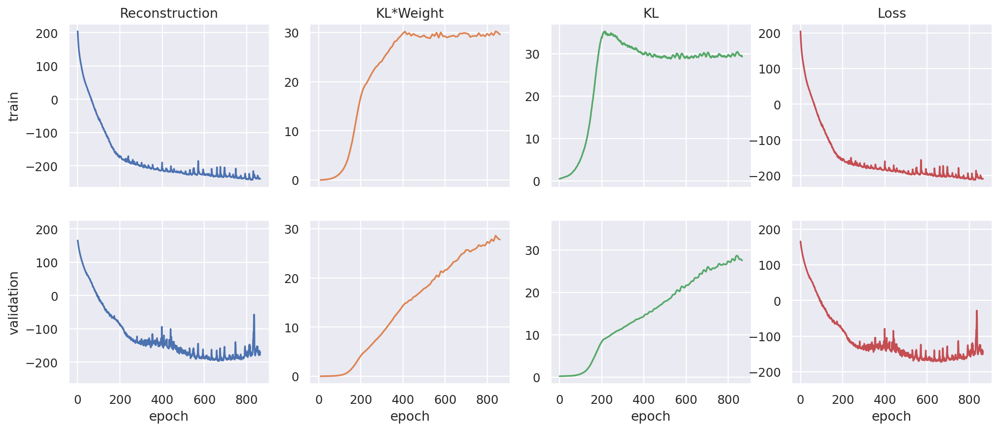

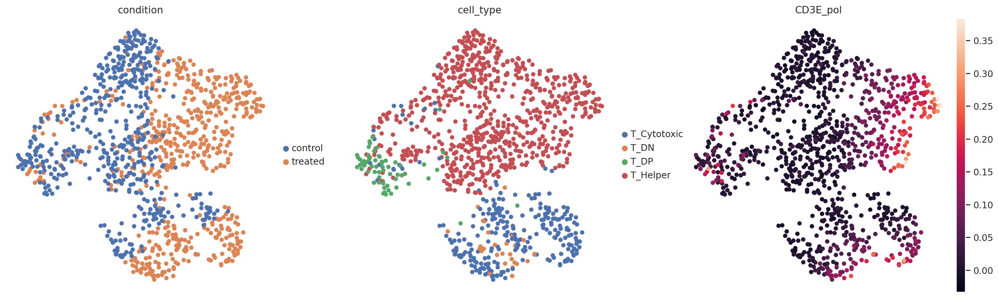

In [110]:
EPOCHS = 10000
obsm_extra_modality_keys=['polarization_morans_i']
latent_name = 'multi_90_model_latent'

model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=2000, 
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam', n_epochs_kl_warmup=400, lr=1e-3,))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, n_extra_modalities=1, obsm_extra_modality_keys=obsm_extra_modality_keys, weights=[0.1, 0.9])
model_cls.setup_anndata(adata, layer='dsb', batch_key='sample', obsm_extra_modality_keys=obsm_extra_modality_keys)
multi_90_model = model_cls(adata, **model_kwargs)
# print(normal_joint_model)
multi_90_model.train(**train_kwargs)
ax = plot_losses(multi_90_model)
adata.obsm[latent_name] = multi_90_model.get_latent_representation()
sc.pp.neighbors(adata, use_rep=latent_name, key_added=latent_name)
sc.tl.umap(adata, neighbors_key=latent_name)
sc.pl.umap(adata, layer='dsb', color=['condition', 'cell_type', 'CD3E_pol'])

INFO     Using column names from columns of adata.obsm['polarization_morans_i']                                    


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: -146.106. Signaling Trainer to stop.


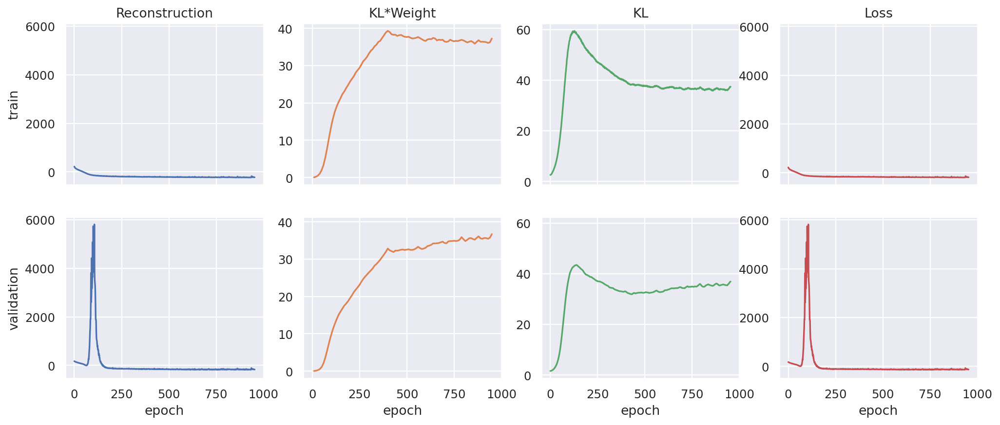

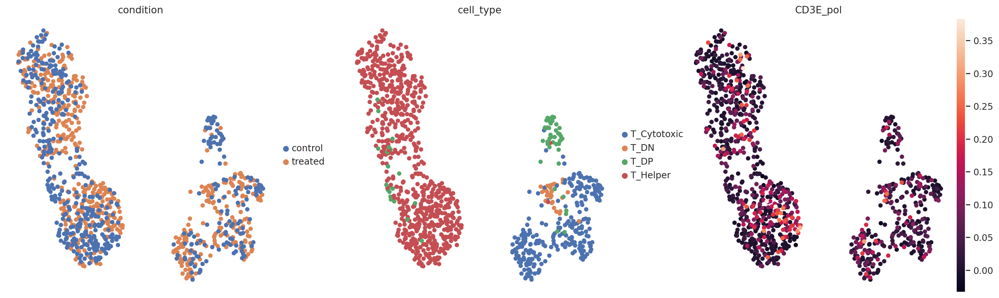

In [104]:
EPOCHS = 10000
obsm_extra_modality_keys=['polarization_morans_i']

model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=2000, 
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(optimizer='Adam', n_epochs_kl_warmup=400, lr=1e-3,))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, n_extra_modalities=1, obsm_extra_modality_keys=obsm_extra_modality_keys, weights=[0.7, 0.3])
model_cls.setup_anndata(adata, layer='dsb', batch_key='sample', obsm_extra_modality_keys=obsm_extra_modality_keys)
multi_30_model = model_cls(adata, **model_kwargs)
# print(normal_joint_model)
multi_30_model.train(**train_kwargs)
ax = plot_losses(multi_30_model)
adata.obsm['multi_30_model_latent'] = multi_30_model.get_latent_representation()
sc.pp.neighbors(adata, use_rep='multi_30_model_latent', key_added='multi_30_model_latent')
sc.tl.umap(adata, neighbors_key='multi_30_model_latent')
sc.pl.umap(adata, layer='dsb', color=['condition', 'cell_type', 'CD3E_pol'])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 200 records. Best score: -161.068. Signaling Trainer to stop.


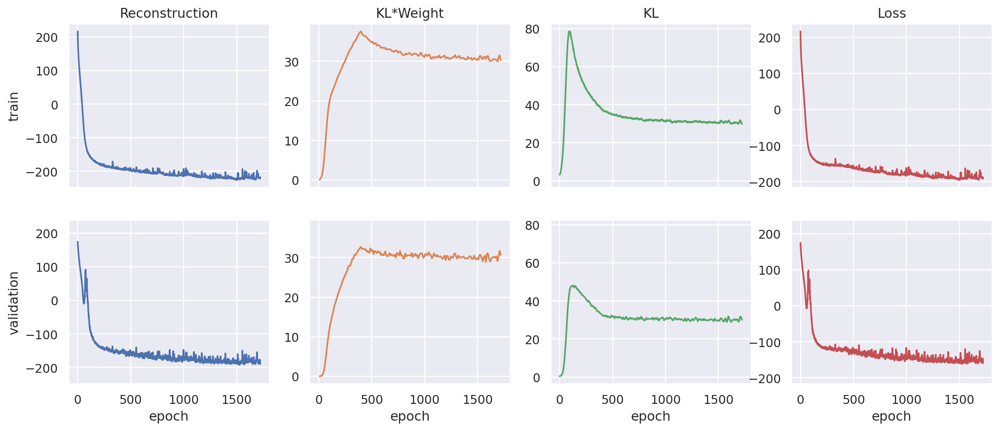

In [52]:
EPOCHS = 10000
model_cls = NormalSCVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=200, batch_size=2000,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(lr=1e-3, optimizer='Adam', n_epochs_kl_warmup=400))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1)
model_cls.setup_anndata(joint_adata, batch_key='sample',)
joint_model = model_cls(joint_adata, **model_kwargs)
joint_model.train(**train_kwargs)
ax = plot_losses(joint_model)

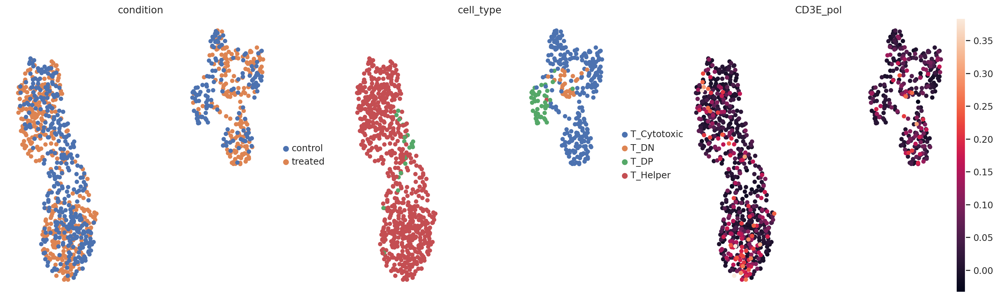

In [53]:
adata.obsm['concat_model_latent'] = joint_model.get_latent_representation()
sc.pp.neighbors(adata, use_rep='concat_model_latent', key_added='concat_model_latent')
sc.tl.umap(adata, neighbors_key='concat_model_latent')
sc.pl.umap(adata, color=['condition', 'cell_type', 'CD3E_pol'])

latent
Abundance            0.805545
Abundance + Noise    0.897836
Concat               0.910080
Multi 0.3            0.911640
Multi 0.5            0.925347
Multi 0.8            0.926574
Multi 0.9            0.791026
Polarization         0.178536
Name: weighted_morans, dtype: float64
                     morans    gearys
latent                               
Abundance          0.114036  0.942842
Abundance + Noise  0.095004  0.958066
Concat             0.234592  0.742034
Multi 0.3          0.400239  0.532093
Multi 0.5          0.534770  0.379656
Multi 0.8          0.656196  0.256113
Multi 0.9          0.840445  0.110725
Polarization       0.864296  0.116928


/tmp/ipykernel_1266491/239627537.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cell_type_sizes = adata.obs.groupby('cell_type').size().rename('cell_type_size')


<Axes: xlabel='Morans Cell Type', ylabel='Morans CD3E Pol'>

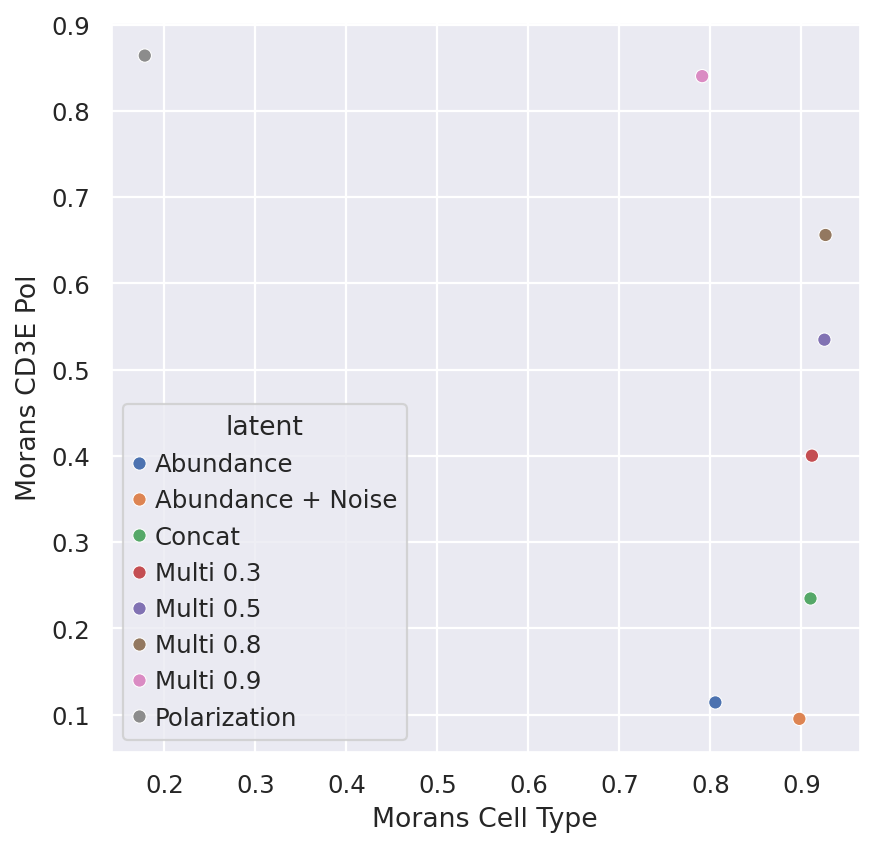

In [114]:
conn_key_list = [f'{s}_connectivities' for s in ['abundance_model_latent', 'noise_model_latent', 'pol_model_latent', 'multi_30_model_latent', 
                                                 'multi_model_latent', 'multi_80_model_latent', 'multi_90_model_latent',
                                                 'concat_model_latent']]
names = ['Abundance', 'Abundance + Noise', 'Polarization', 'Multi 0.3', 'Multi 0.5', 'Multi 0.8', 'Multi 0.9', 'Concat']


# conn_key_list = [f'{s}_connectivities' for s in ['abundance_model_latent', 'pol_model_latent',]] + ['connectivities']
# names = ['Abundance', 'Polarization', 'Abundance PCA', ]


cell_type_autocorr = distr_autocorrelation_in_latent(adata, conn_key_list, names=names, distr_key='cell_type')
pol_autocorr = distr_autocorrelation_in_latent(adata, conn_key_list, names=names, distr_key='polarization_morans_i', vars=['CD3E_pol'])
cell_type_sizes = adata.obs.groupby('cell_type').size().rename('cell_type_size')
n_cells = cell_type_sizes.sum()
cell_type_autocorr.index = ['_'.join(ind.split('_')[2:]) for ind in cell_type_autocorr.index]
cell_type_autocorr = cell_type_autocorr.join(other=cell_type_sizes)
cell_type_autocorr['weighted_morans'] = cell_type_autocorr['morans']*cell_type_autocorr['cell_type_size']



cell_type_autocorr_means = (cell_type_autocorr.groupby('latent')['weighted_morans'].sum() / n_cells)
pol_autocorr_means = pol_autocorr.groupby('latent')[['morans', 'gearys']].mean()
print(cell_type_autocorr_means)
print(pol_autocorr_means)
autocorr = pd.DataFrame({'Morans Cell Type': cell_type_autocorr_means,})
autocorr['Morans CD3E Pol'] = pol_autocorr_means['morans']
sns.scatterplot(autocorr.reset_index(), x='Morans Cell Type', y='Morans CD3E Pol', hue='latent')

In [122]:
all_pol_autocorr = distr_autocorrelation_in_latent(adata, ['multi_80_model_latent_connectivities'], names=['Multi 0.8'], distr_key='polarization_morans_i', )
all_pol_autocorr.sort_values(by='morans', ascending=False).head(10)

,morans,gearys,latent
CD4_pol,0.766656,0.191031,Multi 0.8
CD3E_pol,0.656196,0.256113,Multi 0.8
CD8_pol,0.644867,0.289451,Multi 0.8
CD36_pol,0.628207,0.212078,Multi 0.8
CD11a_pol,0.606852,0.331505,Multi 0.8
CD41_pol,0.473121,0.398546,Multi 0.8
CD45_pol,0.444751,0.390400,Multi 0.8
HLA-ABC_pol,0.338049,0.510784,Multi 0.8
B2M_pol,0.332465,0.545238,Multi 0.8
CD29_pol,0.331894,0.579998,Multi 0.8


In [135]:
adata.to_df('dsb').sort_values(by='CD41', ascending=False)
component = 'RCVCMP0000680_control_1'
print(adata.to_df('counts').sort_values(by='CD41', ascending=False)[['CD41', 'CD45', 'CD3E']])

marker                   CD41  CD45  CD3E
component                                
RCVCMP0000032_control_2  4812  3421   263
RCVCMP0000135_control_2  3653  2778   212
RCVCMP0000680_control_1  3227   651    18
RCVCMP0000270_control_2  3025  1556    82
RCVCMP0000252_control_2  2847  2444   213
...                       ...   ...   ...
RCVCMP0001195_treated_2     0  1197   120
RCVCMP0001209_treated_2     0  1377   136
RCVCMP0000859_control_1     0  1214    32
RCVCMP0001233_treated_2     0  1376    95
RCVCMP0000023_treated_2     0  1619    51

[1069 rows x 3 columns]


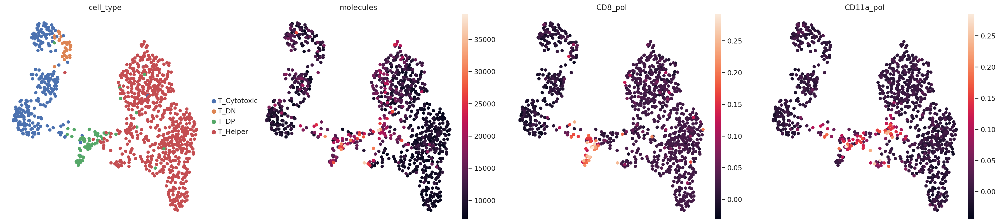

In [153]:
latent_name = 'multi_80_model_latent'
sc.pp.neighbors(adata, use_rep=latent_name, key_added=latent_name)
sc.tl.umap(adata, neighbors_key=latent_name)
pol_keys = ['CD8_pol', 'CD11a_pol']
for pol_key in pol_keys:
    adata.obs[pol_key] = adata.obsm['polarization_morans_i'][pol_key]
sc.pl.umap(adata, layer='dsb', color=['cell_type', 'molecules', *pol_keys,])
adata.obs.drop(columns=pol_keys, inplace=True)

In [127]:
components = adata.to_df('dsb')[['CD8']]
components['CD11a_pol'] = adata.obsm['polarization_morans_i']['CD11a_pol']
components.sort_values(by='CD11a_pol', ascending=False)
component = 'RCVCMP0000468_control_2'

gld = compute_graph_layout(pg_data=pg_data, component=component)
plot_cell_smooth(graph_layout_data=gld, marker_1='CD11a')

<Axes: xlabel='molecules', ylabel='Count'>

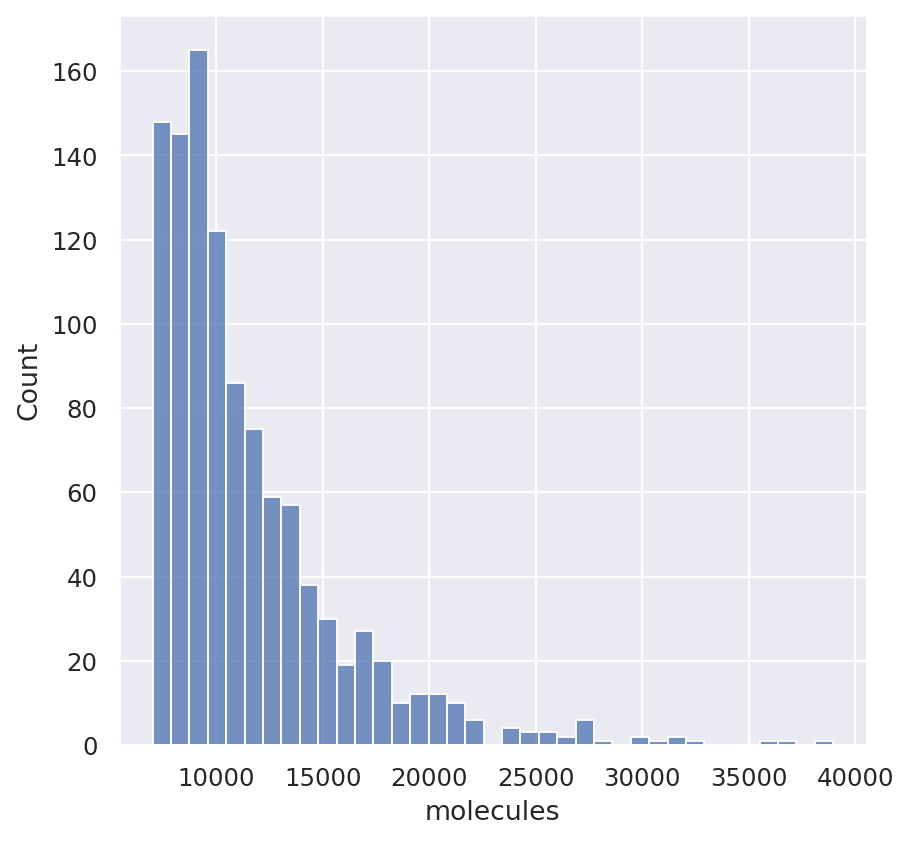

In [150]:
sns.histplot(adata.obs['molecules'])

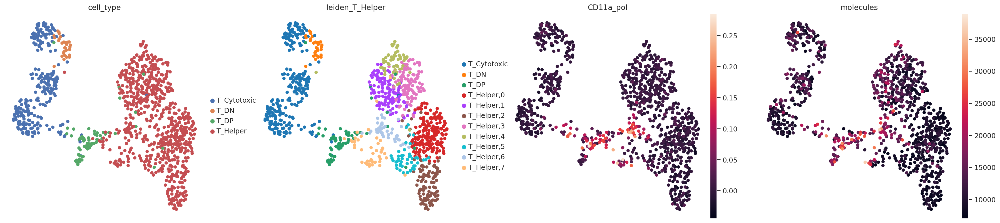

/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning:

invalid value encountered in log2



,names,scores,logfoldchanges,pvals,pvals_adj
0,CD45,8.256485,3.069077,1.500255e-16,1.200204e-14
6,CD2,5.662673,2.407457,1.490332e-08,1.703237e-07
2,HLA-ABC,6.316887,1.829578,2.668841e-10,7.116910e-09
7,CD45RB,5.496145,1.746089,3.881825e-08,3.881825e-07
3,CD54,6.078248,1.739228,1.215030e-09,2.430060e-08
9,CD229,4.854569,1.729280,1.206488e-06,9.651903e-06
5,CD18,5.793516,1.696001,6.892806e-09,9.190408e-08
4,B2M,5.845555,1.685482,5.048808e-09,8.078092e-08
13,CD49D,3.692595,1.594316,2.219775e-04,1.268443e-03
33,CD161,2.351455,1.331691,1.870014e-02,4.043274e-02


In [151]:
sc.tl.leiden(adata, neighbors_key='multi_80_model_latent', restrict_to=('cell_type', ['T_Helper']), key_added='leiden_T_Helper')
pol_keys = ['CD11a_pol',]
for pol_key in pol_keys:
    adata.obs[pol_key] = adata.obsm['polarization_morans_i'][pol_key]

adata.obs['molecules_log1p'] = np.log1p(adata.obs['molecules'])

sc.pl.umap(adata, layer='dsb', color=['cell_type', 'leiden_T_Helper', *pol_keys, 'molecules'])
adata.obs.drop(columns=pol_keys, inplace=True)

leiden_T_Helper_dict = {
    'T_Helper,6': 'T_Helper_CD11a_pol',
    **{
        f'T_Helper,{i}': 'T_Helper' for i in range(8) if i != 6
    }
}

adata.obs['leiden_T_Helper'] = adata.obs['leiden_T_Helper'].map(leiden_T_Helper_dict)

sc.tl.rank_genes_groups(adata, layer='dsb', groupby='leiden_T_Helper', method='wilcoxon', groups=['T_Helper_CD11a_pol'], reference='T_Helper')
de = sc.get.rank_genes_groups_df(adata, group='T_Helper_CD11a_pol', pval_cutoff=0.05)
de.sort_values(by='logfoldchanges', ascending=False)

/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
Embeddings: 100%|██████████| 3/3 [00:04<00:00,  1.45s/it]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scib_metrics/benchmark/_core.py:295: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Aggregate score' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df.loc[_METRIC_TYPE, per_class_score.columns] = _AGGREGATE_SCORE


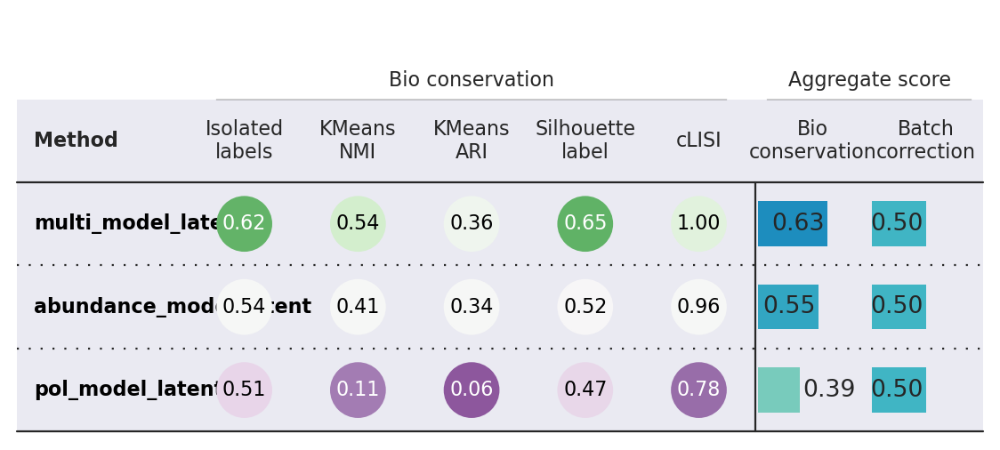

/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:374: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)
Embeddings: 100%|██████████| 3/3 [00:02<00:00,  1.40it/s]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scib_metrics/benchmark/_core.py:295: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Aggregate score' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df.loc[_METRIC_TYPE, per_class_score.columns] = _AGGREGATE_SCORE


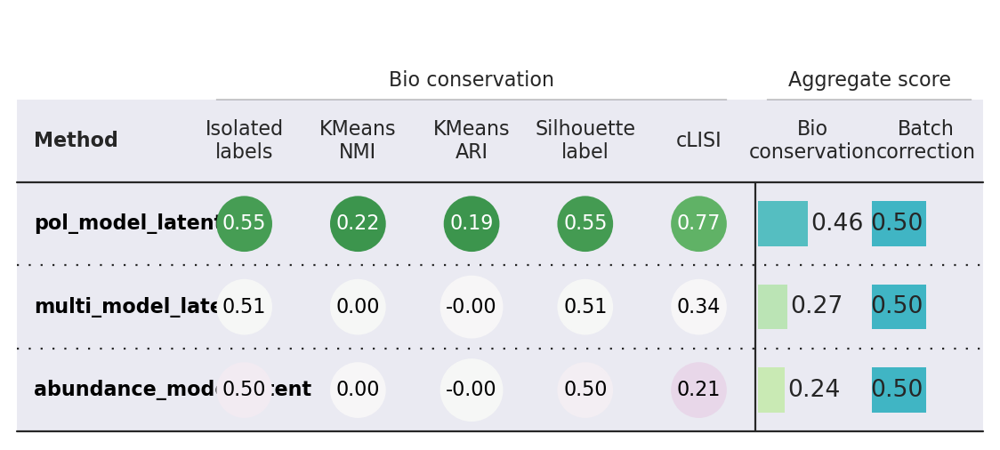

In [23]:
for key in ['cell_type', 'condition']:
        bm = Benchmarker(
                adata=adata,
                batch_key='sample',
                label_key=key,
                batch_correction_metrics=None,
                bio_conservation_metrics=BioConservation(),
                embedding_obsm_keys=['abundance_model_latent', 'pol_model_latent', 'multi_model_latent'],
                n_jobs=1,
        )
        bm.benchmark()
        bm.plot_results_table(min_max_scale=False)

## Joint model has trouble taking into account the CD3E_pol
Variation insignifcant relative to variation in abundance

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 250 records. Best score: -163.165. Signaling Trainer to stop.


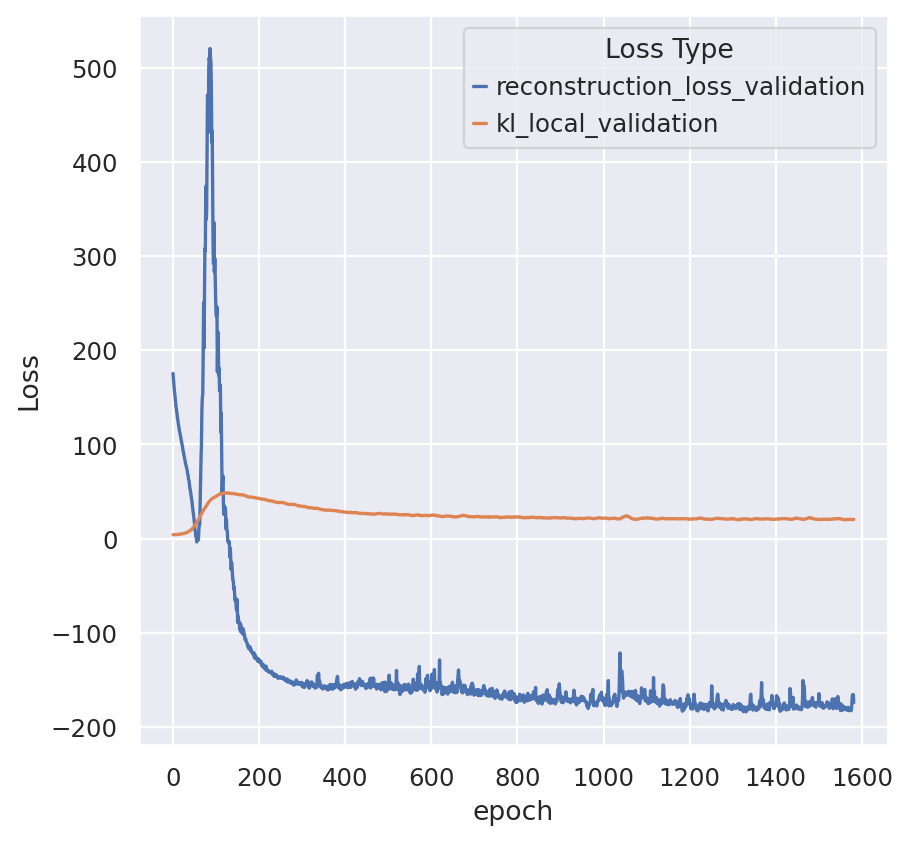

In [8]:
EPOCHS = 10000
model_cls = CytoVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=250, batch_size=2000,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=400))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, prior_mixture=True, use_batch_norm='both')
model_cls.setup_anndata(joint_adata, batch_key='sample',)
joint_model = model_cls(joint_adata, **model_kwargs)
joint_model.train(**train_kwargs)
ax = plot_validation_loss(joint_model, semilogy=False)

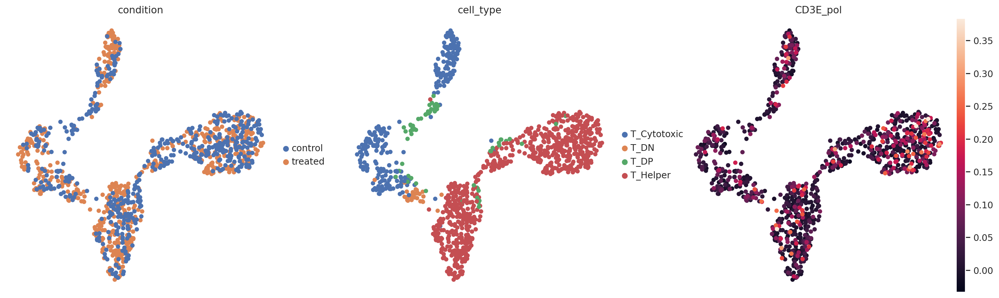

In [9]:
joint_adata.obsm['model_latent'] = joint_model.get_latent_representation()
sc.pp.neighbors(joint_adata, use_rep='model_latent', key_added='model_latent')
sc.tl.umap(joint_adata, neighbors_key='model_latent')
sc.pl.umap(joint_adata, color=['condition', 'cell_type', 'CD3E_pol'])

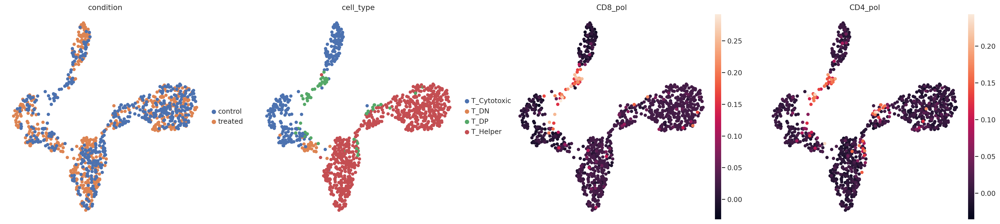

In [32]:
sc.tl.leiden(joint_adata, neighbors_key='model_latent', key_added='joint_model_leiden')
sc.pl.umap(joint_adata, color=['condition', 'cell_type', 'CD8_pol', 'CD4_pol', ])

In [27]:
sc.tl.rank_genes_groups(joint_adata, groupby='joint_model_leiden', method='wilcoxon', )
joint_de = sc.get.rank_genes_groups_df(joint_adata, group=None, pval_cutoff=0.05)
pol_markers_de = [m for m in joint_de['names'] if 'pol' in m]
joint_de[joint_de['names'].isin(pol_markers_de)].sort_values(by='pvals_adj', ascending=True).head(20)
# sc.pl.rank_genes_groups_dotplot(joint_adata, values_to_plot='scores', var_names=[v for v in joint_adata.var_names if 'pol' in v], cmap='bwr')

/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/sit

,group,names,scores,logfoldchanges,pvals,pvals_adj
335,5,CD8_pol,-11.318578,NaN,1.061810e-29,2.831492e-28
455,9,CD8_pol,10.186267,3.225625,2.283656e-24,3.653850e-22
456,9,CD4_pol,9.540493,4.620727,1.421544e-21,1.137235e-19
389,6,CD8_pol,-9.227572,-3.067219,2.768338e-20,4.921490e-19
282,4,CD8_pol,-7.337202,-0.865270,2.181051e-13,1.905267e-12
458,9,CD45RA_pol,7.351346,3.747851,1.962206e-13,7.848824e-12
64,0,CD11a_pol,-6.878767,NaN,6.037266e-12,3.219875e-11
63,0,CD45RA_pol,-6.843371,NaN,7.735095e-12,3.992307e-11
9,0,CD8_pol,6.591106,0.152875,4.365607e-11,2.116658e-10
459,9,B2M_pol,6.789847,NaN,1.122523e-11,3.592074e-10


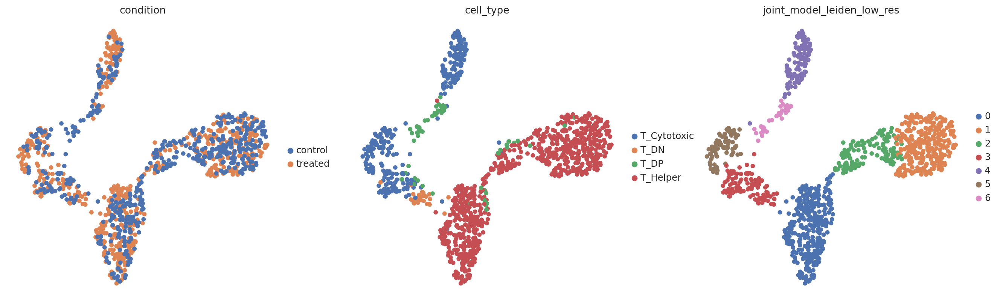

In [28]:
sc.tl.leiden(joint_adata, neighbors_key='model_latent', key_added='joint_model_leiden_low_res', resolution=0.5)
sc.pl.umap(joint_adata, color=['condition', 'cell_type', 'joint_model_leiden_low_res', ])

In [34]:
sc.tl.rank_genes_groups(joint_adata, groupby='joint_model_leiden_low_res', method='wilcoxon', groups=['5'], reference='4')
joint_de = sc.get.rank_genes_groups_df(joint_adata, group=None, pval_cutoff=0.05)
joint_de.sort_values(by='pvals_adj', ascending=True).head(20)
# pol_markers_de = [m for m in joint_de['names'] if 'pol' in m]
# joint_de[joint_de['names'].isin(pol_markers_de)].sort_values(by='pvals_adj', ascending=True).head(20)

/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(


,names,scores,logfoldchanges,pvals,pvals_adj
44,CD55,-10.741161,NaN,6.521879e-27,1.043501e-24
43,CD11a,-10.532345,-2.812942,6.128826e-26,4.903060e-24
0,CD49D,9.688498,3.489256,3.374517e-22,1.799742e-20
1,CD18,9.651313,NaN,4.853058e-22,1.941223e-20
42,CD127,-9.588382,-2.924006,8.947751e-22,2.386067e-20
2,CD29,9.591242,NaN,8.703093e-22,2.386067e-20
3,CD45RB,9.531172,NaN,1.555180e-21,3.554697e-20
4,CD244,9.239401,NaN,2.478808e-20,4.957616e-19
41,CD27,-9.110679,-3.507806,8.186815e-20,1.455434e-18
40,CD45RA,-8.773140,-3.441895,1.737514e-18,2.780022e-17


## Concatenated latent spaces better take into account both modalities

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 250 records. Best score: -242.962. Signaling Trainer to stop.


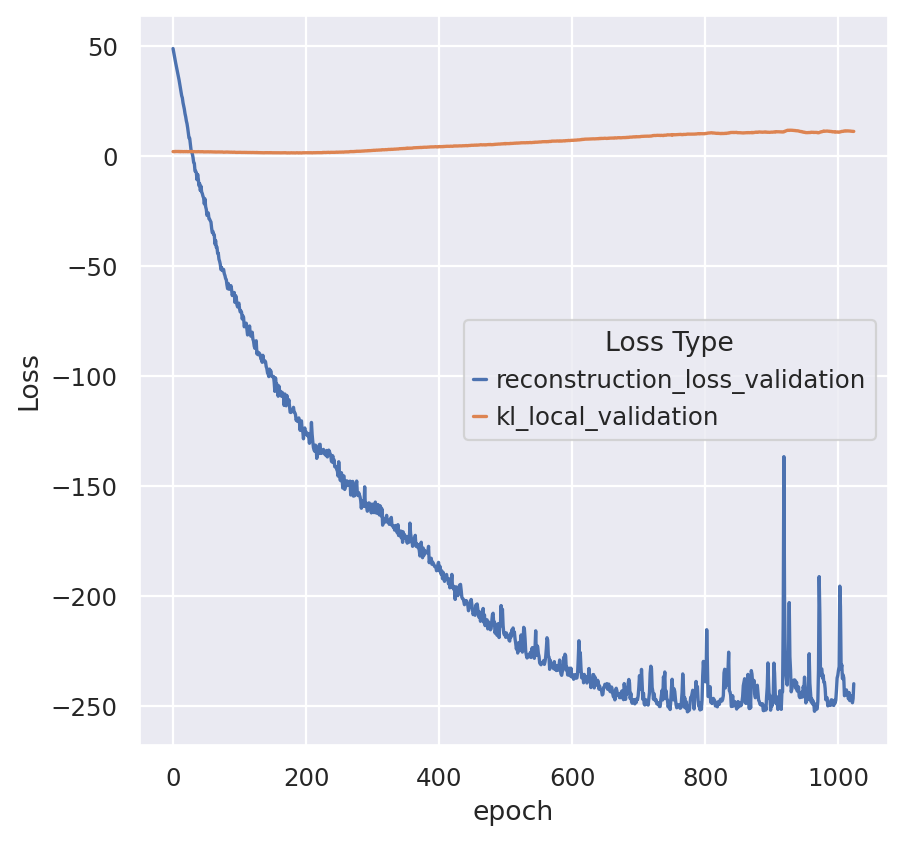

In [15]:
EPOCHS = 10000
model_cls = CytoVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=250, batch_size=2000,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=400))
model_kwargs = dict(n_latent=10, n_hidden=128, n_layers=1, dropout_rate=0.1, prior_mixture=True, use_batch_norm='both')
model_cls.setup_anndata(pol_adata, batch_key='sample',)
pol_model = model_cls(pol_adata, **model_kwargs)
pol_model.train(**train_kwargs)
ax = plot_validation_loss(pol_model, semilogy=False)

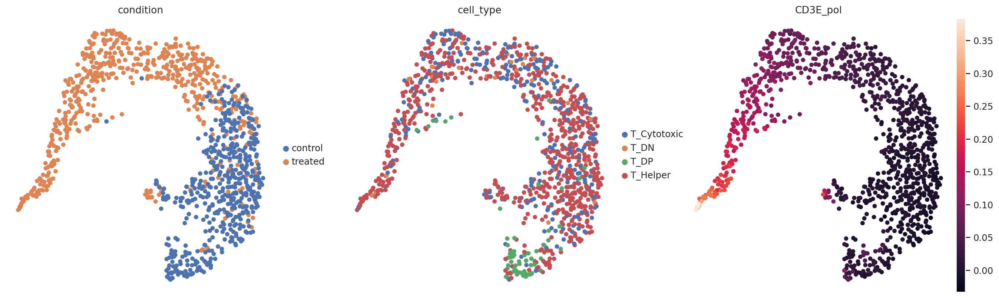

In [16]:
pol_adata.obsm['model_latent'] = pol_model.get_latent_representation()
sc.pp.neighbors(pol_adata, use_rep='model_latent', key_added='model_latent')
sc.tl.umap(pol_adata, neighbors_key='model_latent')
sc.pl.umap(pol_adata, color=['condition', 'cell_type', 'CD3E_pol'])

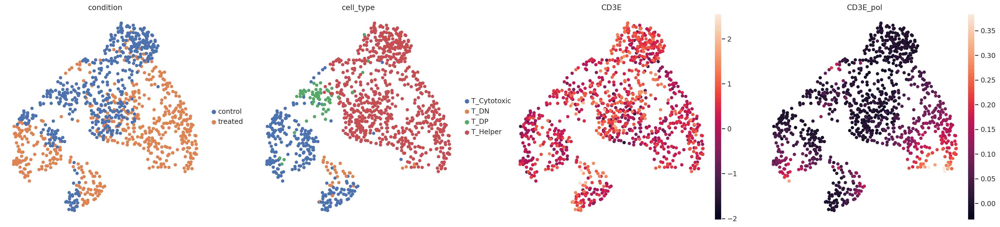

In [17]:
adata.obsm['concat_latent'] = np.concatenate((adata.obsm['model_latent'], pol_adata.obsm['model_latent']), axis=1)
adata.obs['CD3E_pol'] = adata.obsm['polarization_morans_i']['CD3E_pol']
sc.pp.neighbors(adata, use_rep='concat_latent', key_added='concat_latent')
sc.tl.umap(adata, neighbors_key='concat_latent')
sc.pl.umap(adata, layer='dsb', color=['condition', 'cell_type', 'CD3E', 'CD3E_pol'])


/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:305: RuntimeWarning: invalid value encountered in log
  dispersion = np.log(dispersion)
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:412: UserWarning: `n_top_genes` > number of normalized dispersions, returning all genes with normalized dispersions.
  warnings.warn(msg, UserWarning)


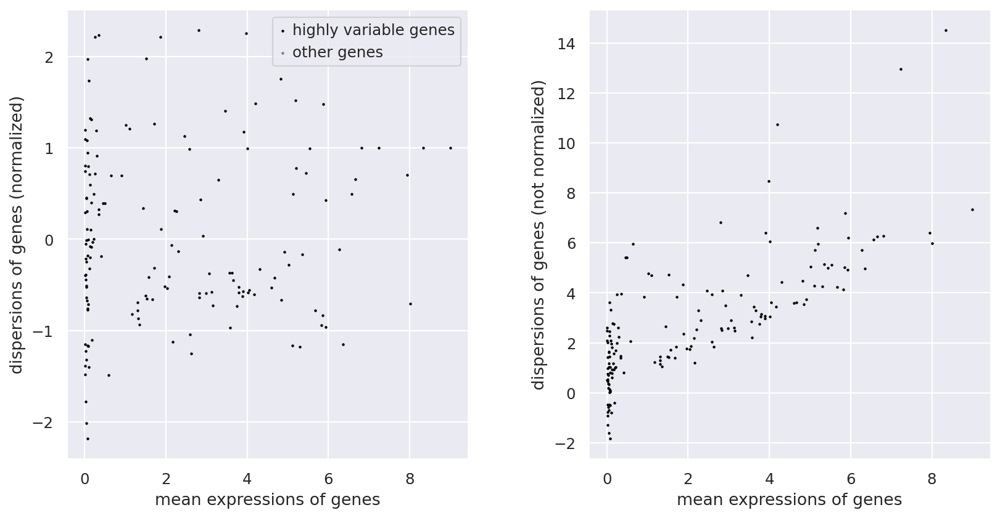

True


In [454]:
joint_df = pd.concat((np.arcsinh(adata.to_df('counts')), 20*adata.obsm['polarization_morans_i']), axis=1)
# joint_df = center_feature_matrix(joint_df) 
all_joint_adata = anndata.AnnData(
    X=joint_df,
    obs=adata.obs
)
# joint_adata = all_joint_adata.copy()
sc.pp.highly_variable_genes(all_joint_adata, flavor='seurat', n_top_genes=160)
sc.pl.highly_variable_genes(all_joint_adata)
print(all_joint_adata.var['highly_variable']['CD3E_pol'])
joint_adata = all_joint_adata[:, all_joint_adata.var[all_joint_adata.var['highly_variable']].index]

In [455]:
sc.tl.rank_genes_groups(joint_adata, groupby='condition', use_raw=False, method='wilcoxon')
joint_de = sc.get.rank_genes_groups_df(joint_adata, group='treated', pval_cutoff=0.05)
joint_de.sort_values(by='pvals_adj', ascending=False)

/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:639: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = {}
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:455: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(


,names,scores,logfoldchanges,pvals,pvals_adj
24,CD328,2.212525,0.137747,2.693040e-02,4.910837e-02
25,mIgG2a,-2.277970,0.010876,2.272834e-02,4.193920e-02
26,CD54,-2.313722,-0.090109,2.068298e-02,3.862484e-02
27,CD71,-2.379565,-0.197661,1.733311e-02,3.276381e-02
28,CD268_pol,-2.418891,-3.544125,1.556790e-02,2.979042e-02
...,...,...,...,...,...
82,HLA-ABC_pol,-8.986552,NaN,2.551068e-19,7.908309e-18
83,CD41,-13.128768,-1.452365,2.252910e-39,8.730025e-38
1,CD162,14.545126,0.954945,6.271519e-48,3.240285e-46
84,CD4,-14.744043,-1.254946,3.360457e-49,2.604354e-47


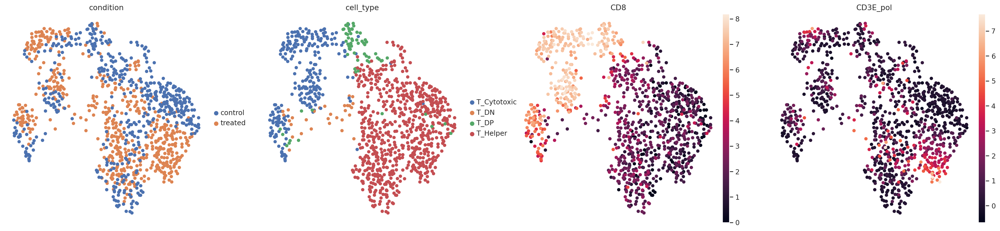

In [456]:
sc.pp.pca(joint_adata)
sc.pp.neighbors(joint_adata)
sc.tl.umap(joint_adata)
sc.pl.umap(joint_adata, color=['condition', 'cell_type', 'CD8', 'CD3E_pol'])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 50 records. Best score: 98.992. Signaling Trainer to stop.


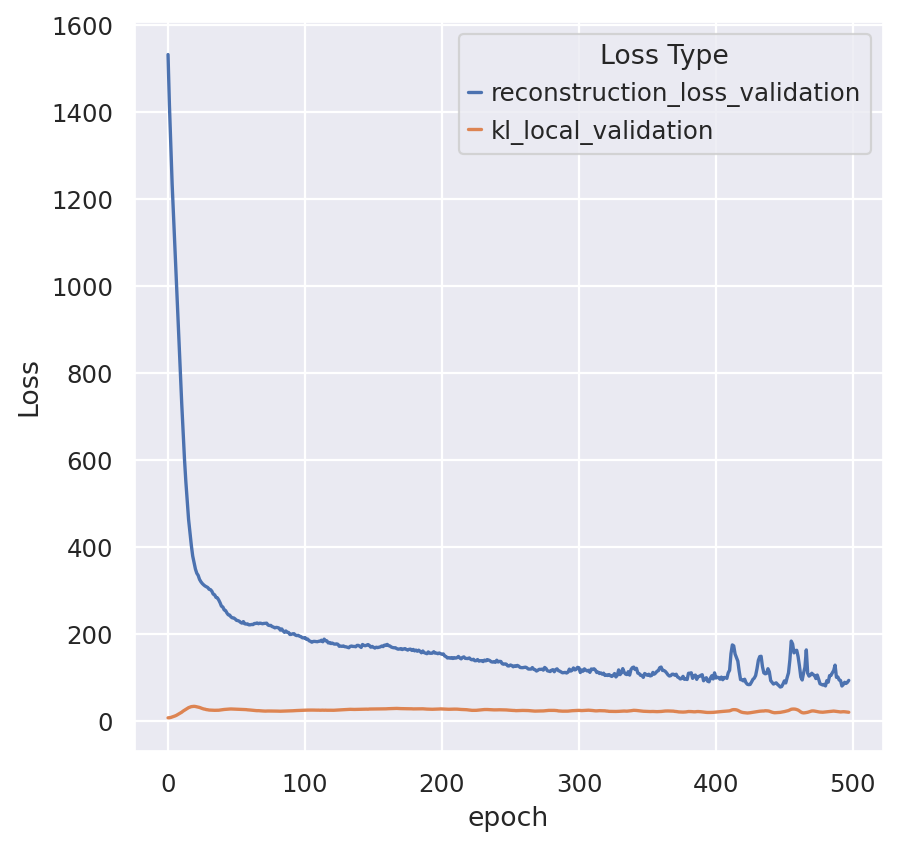

In [457]:
EPOCHS = 10000
model_cls = CytoVI
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=50, batch_size=2000,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=400))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, prior_mixture=True, use_batch_norm='both')
# model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, use_batch_norm='both')
model_cls.setup_anndata(joint_adata, batch_key='sample',)
joint_model = model_cls(joint_adata, **model_kwargs)
joint_model.train(**train_kwargs)
ax = plot_validation_loss(joint_model, semilogy=False)

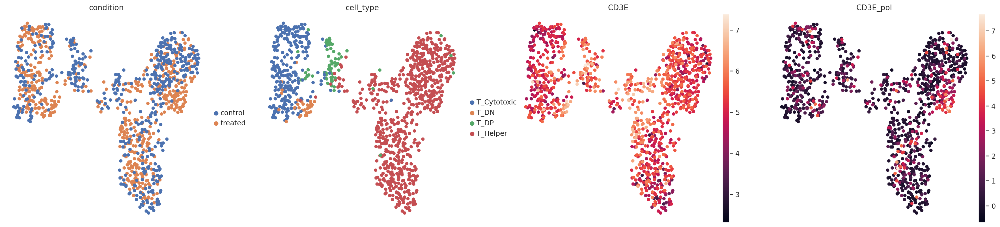

In [458]:
joint_adata.obsm['model_latent'] = joint_model.get_latent_representation()
sc.pp.neighbors(joint_adata, use_rep='model_latent', key_added='model_latent')
sc.tl.umap(joint_adata, neighbors_key='model_latent')
sc.pl.umap(joint_adata, color=['condition', 'cell_type', 'CD3E', 'CD3E_pol'])

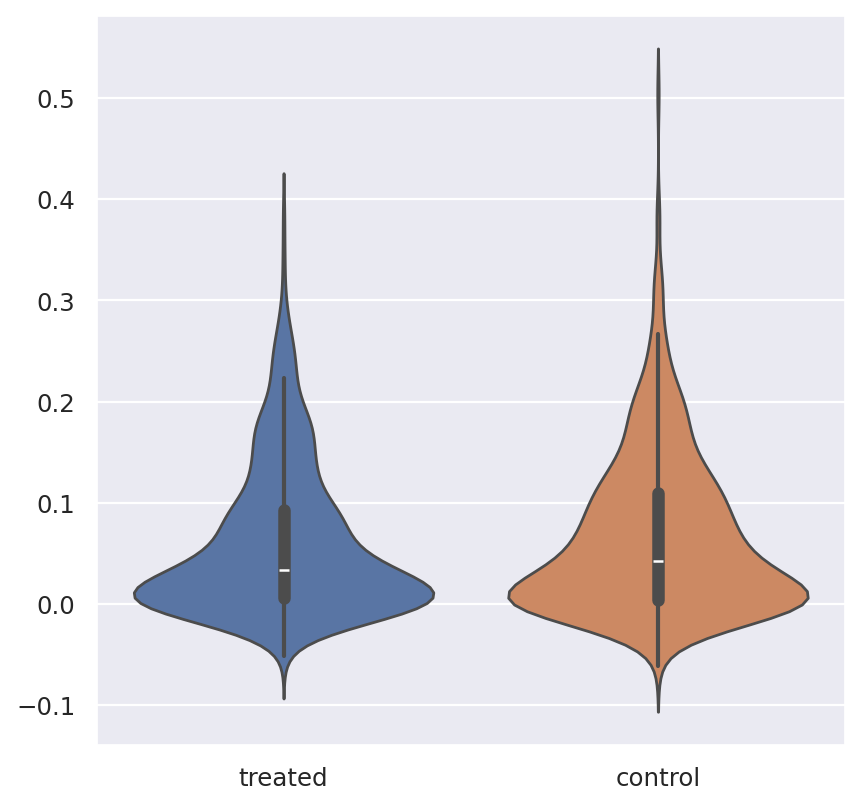

In [45]:
control_pol = pg_data.polarization[pg_data.polarization['sample'] == 'control']
treated_pol = pg_data.polarization[pg_data.polarization['sample'] == 'treated']
ax = sns.violinplot({'treated': treated_pol[treated_pol['marker'] == 'CD3E']['morans_i'], 'control': control_pol[control_pol['marker'] == 'CD3E']['morans_i']})

In [ ]:
adata = pg_data.adata.copy()
adata.raw = adata.copy()
orig_adata = adata.copy()
sc.pp.calculate_qc_metrics(adata, percent_top=None, inplace=True, var_type='proteins')

/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/anndata/utils.py:429: FutureWarning: Importing read_elem from `anndata.experimental` is deprecated. Import anndata.io.read_elem instead.
  warnings.warn(msg, FutureWarning)


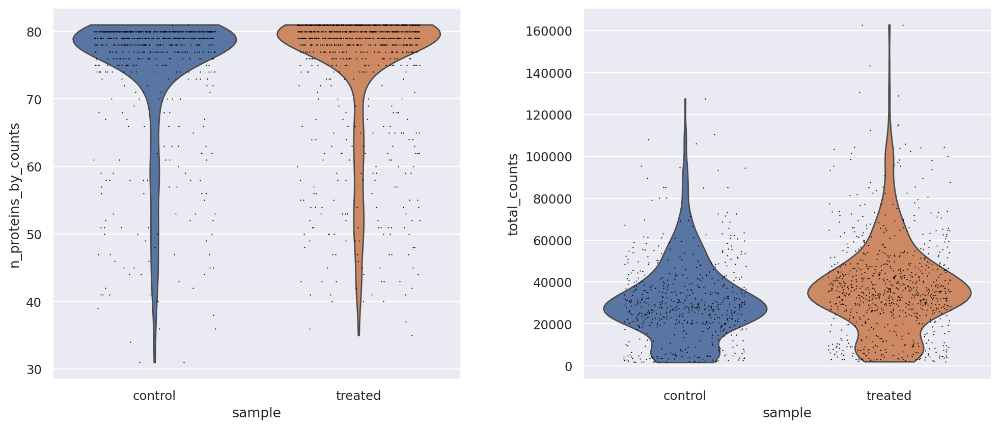

In [4]:
sc.pl.violin(
    adata,
    ["n_proteins_by_counts", "total_counts",],
    groupby='sample',
    jitter=0.3,
    multi_panel=True,
)

/tmp/ipykernel_2106965/1817677247.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  molecule_rank_df["rank"] = molecule_rank_df.groupby(["sample"])["molecules"].rank(
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/pixelator/plot/__init__.py:133: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  edge_rank_df["rank"] = edge_rank_df.groupby([group_by])["molecules"].rank(


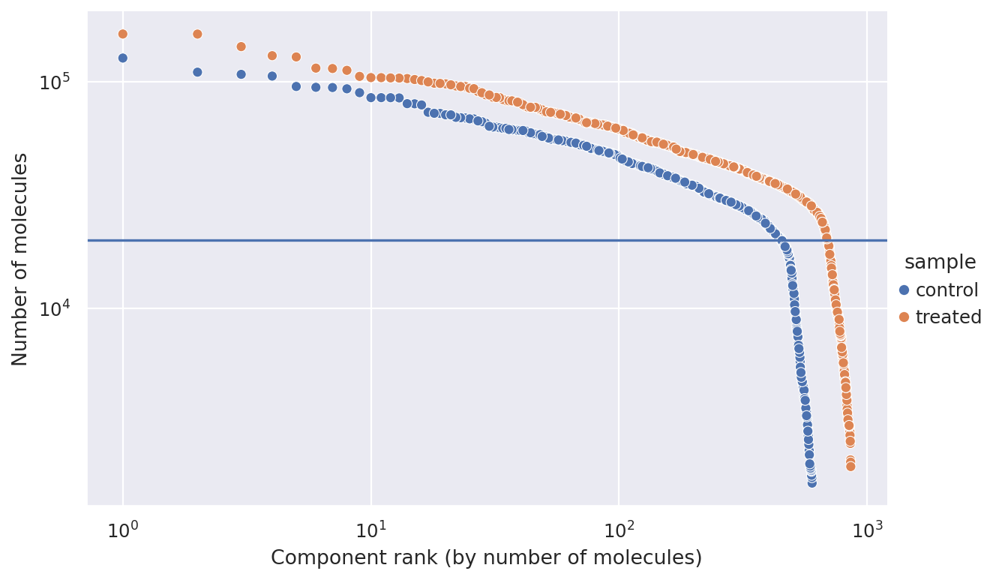

In [5]:
molecule_rank_df = adata.obs[["sample", "molecules"]].copy()
molecule_rank_df["rank"] = molecule_rank_df.groupby(["sample"])["molecules"].rank(
    ascending=False, method="first"
)
fig_intersection, ax = molecule_rank_plot(molecule_rank_df, group_by="sample")
ax.axhline(y=20000)

/tmp/ipykernel_2106965/61645433.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/pixelator/plot/__init__.py:271: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped_data = data.groupby(color_by).size().reset_index(name="n")


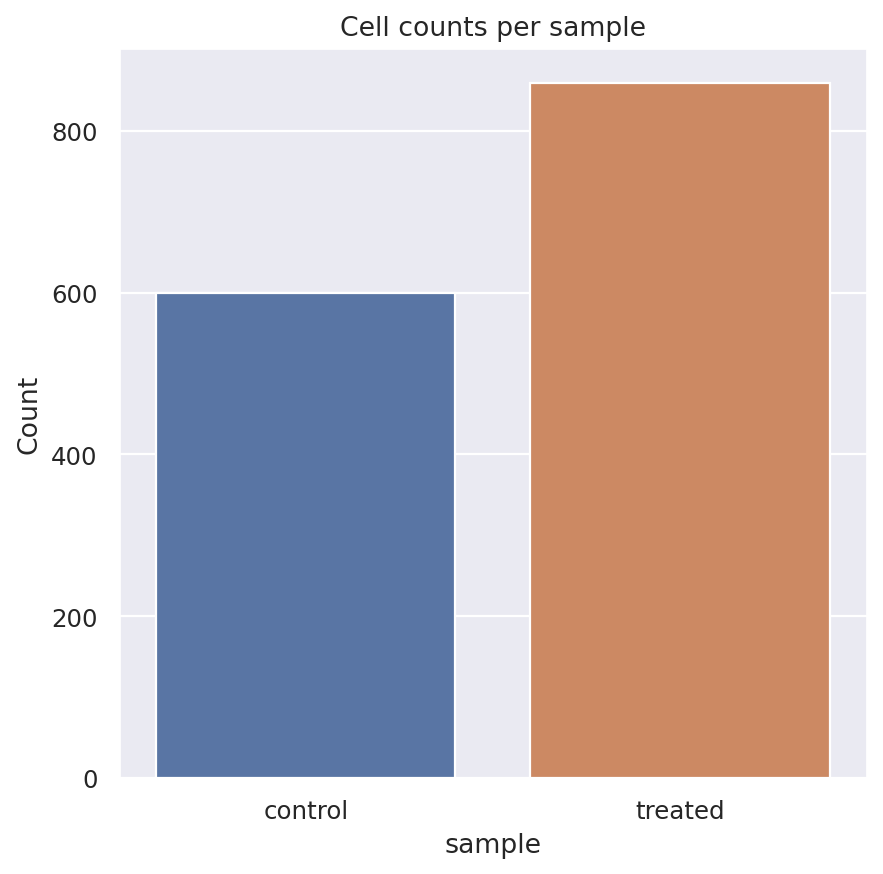

In [6]:
cells_per_sample_df = (
    adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
)

fig, ax = cell_count_plot(adata.obs, color_by="sample")

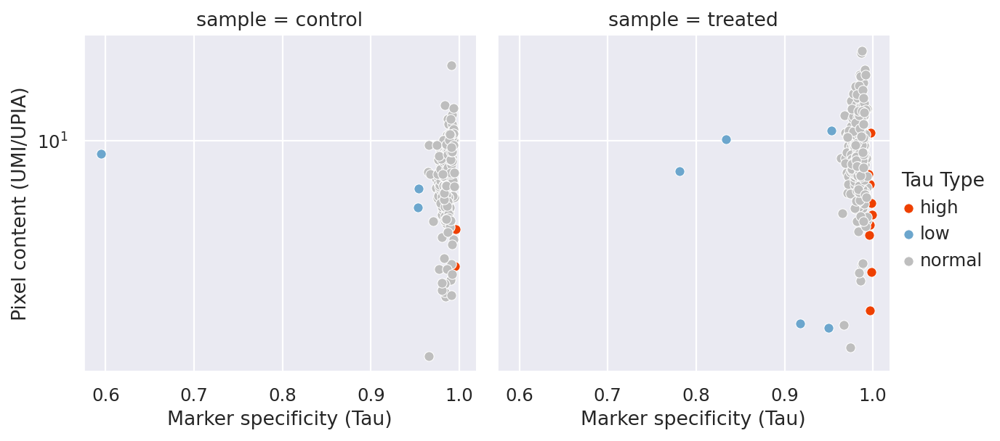

In [7]:
tau_metrics_df = adata.obs[["sample", "tau", "mean_molecules_per_a_pixel", "tau_type"]]
tau_metrics_df = tau_metrics_df.rename(columns={"mean_molecules_per_a_pixel": "umi_per_upia"})


fig, ax = scatter_umi_per_upia_vs_tau(tau_metrics_df, group_by="sample")

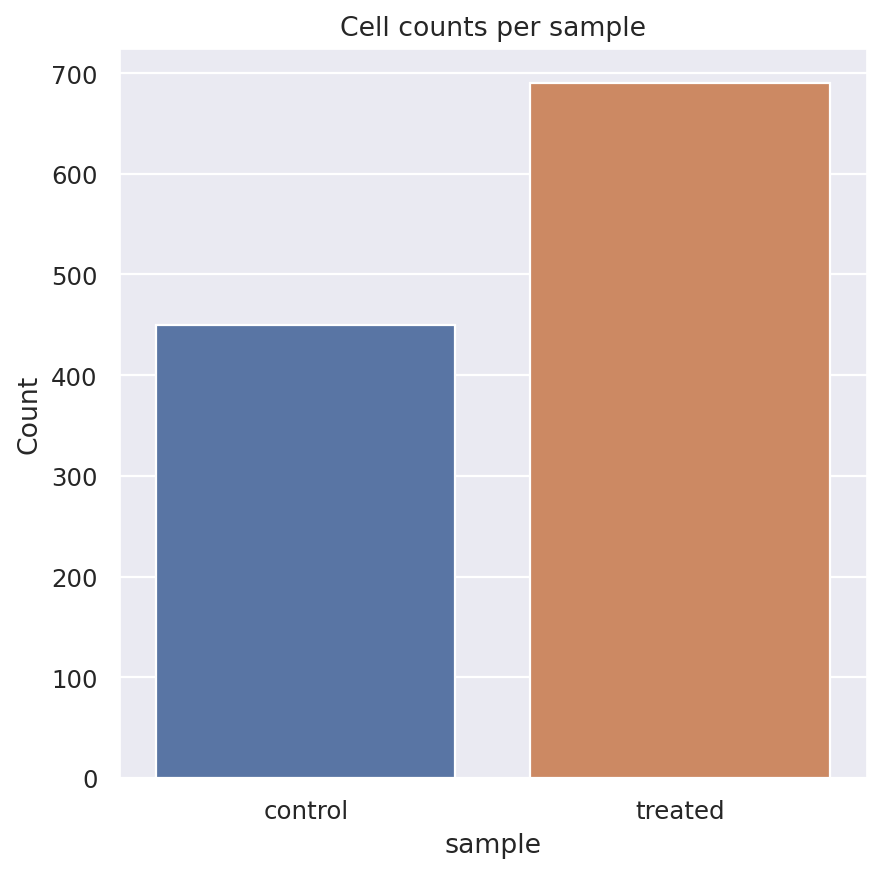

In [8]:
components = adata.obs[
    (adata.obs['tau_type'] == 'normal') & 
    (adata.obs['molecules'] > 20000)
].index
vars = [v for v in adata.var_names if v != 'Rituximab']
adata = orig_adata[components, vars]
cells_per_sample_df = (
    adata.obs.groupby("sample").size().to_frame(name="size").reset_index()
)

fig, ax = cell_count_plot(adata.obs, color_by="sample")

/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:207: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


[]

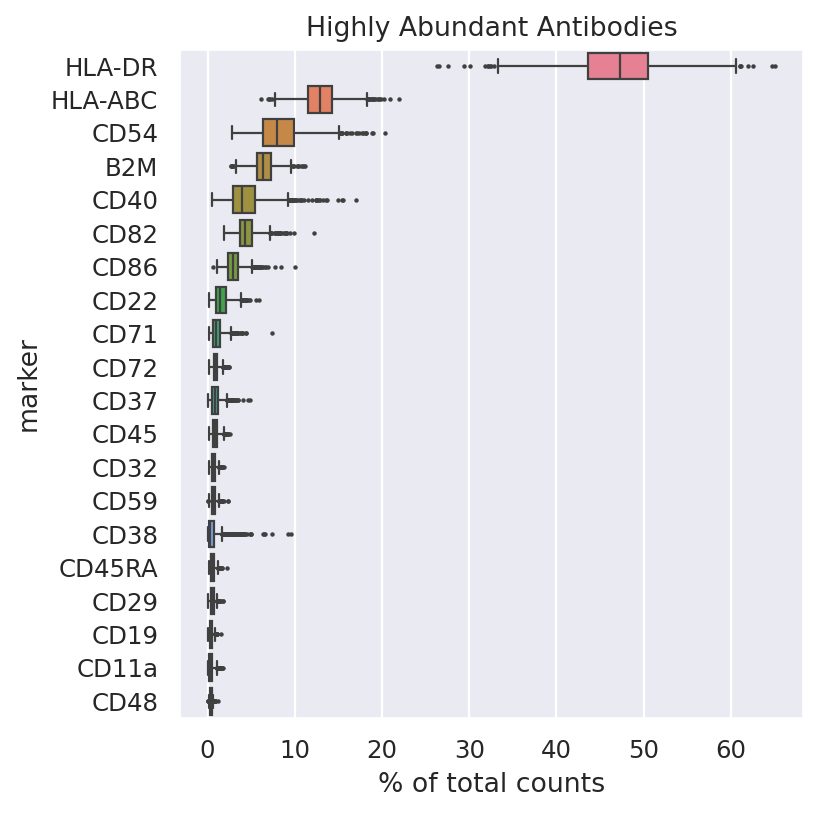

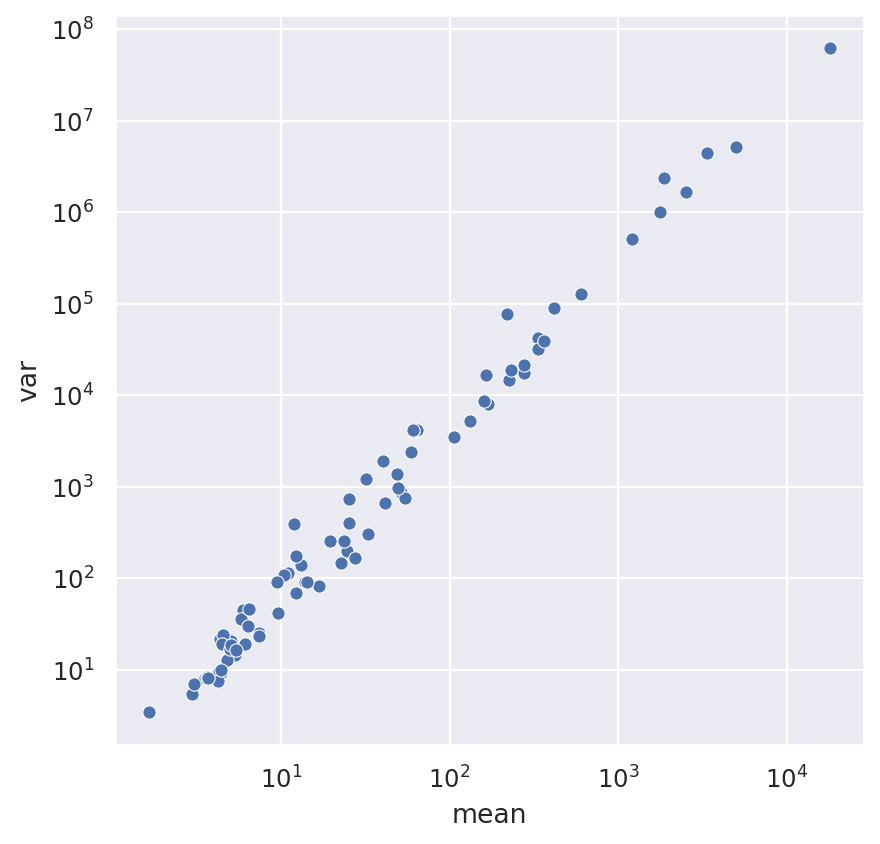

In [9]:
ax = sc.pl.highest_expr_genes(adata, n_top=20, show=False)
ax.set_title('Highly Abundant Antibodies')
stats = adata.to_df().agg(['mean', 'var',], axis=0).T
fig, ax = plt.subplots(1)
sns.scatterplot(x=stats['mean'], y=stats['var'], ax=ax)
ax.loglog()
# var_genes = sc.pp.highly_variable_genes(adata, flavor='seurat_v3', n_top_genes=20, batch_key='sample', layer='counts', inplace=False)
# sc.pl.highly_variable_genes(var_genes, show=True, log=True)

In [14]:
adata.layers['counts'] = adata.X.copy()
adata.layers['dsb'] = dsb_normalize(adata.to_df('counts'), isotype_controls=['mIgG1', 'mIgG2a', 'mIgG2b'])
adata.layers['clr_by_cell'] = clr_transformation(adata.to_df('counts'), axis=1)
adata.layers['clr_by_ab'] = clr_transformation(adata.to_df('counts'), axis=0)
adata.layers['log1p'] = np.log1p(adata.to_df('counts'))

<Axes: title={'center': 'Cumulative Variance Explained'}>

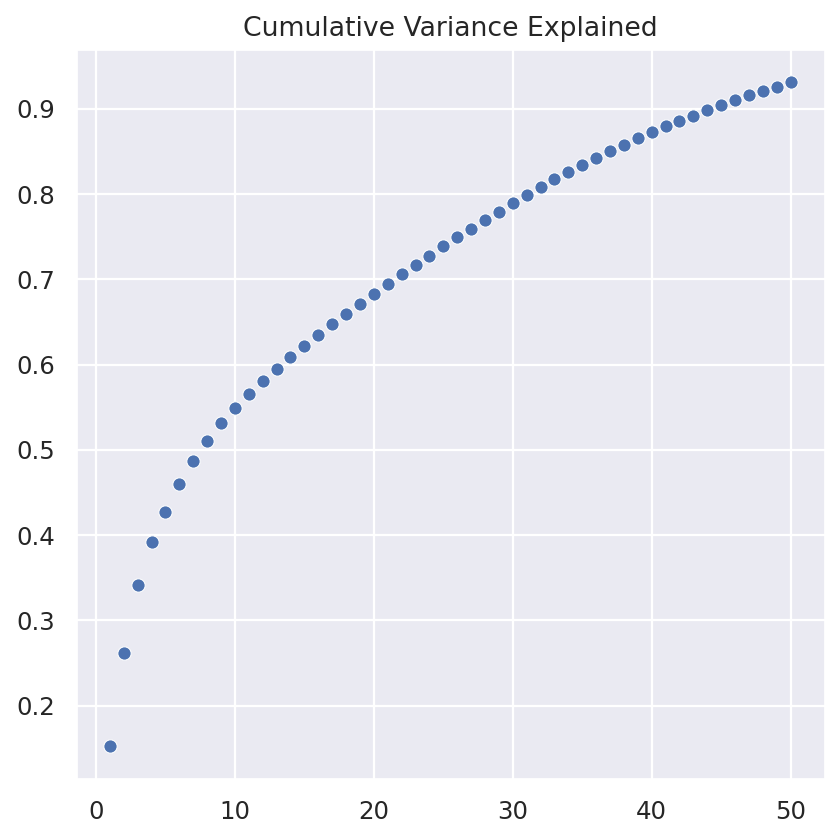

In [15]:
sc.tl.pca(adata, layer='dsb')
plot_cumulative_variance(adata)

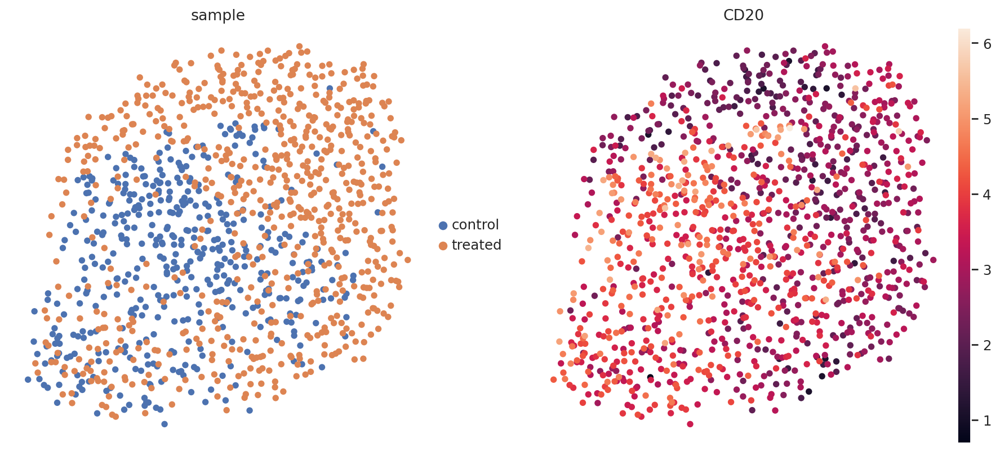

In [16]:
sc.pp.neighbors(adata,)
sc.tl.umap(adata, )
sc.pl.umap(adata, layer='log1p', color=['sample', 'CD20'])

In [24]:
sc.tl.rank_genes_groups(adata, groupby='sample', layer='dsb', use_raw=False, method='wilcoxon')
abundance_de = sc.get.rank_genes_groups_df(adata, group=None, pval_cutoff=0.05, log2fc_min=1)
abundance_de.sort_values(by='logfoldchanges', ascending=False)

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,control,CD20,27.654522,4.358156,2.462323e-168,1.969858e-166
7,treated,CD45RA,13.435252,3.208849,3.757883e-41,1.002102e-39
8,treated,CD45,12.223887,2.324307,2.317334e-34,3.707735e-33
9,treated,CD84,10.189302,2.214257,2.213464e-24,1.967524e-23
1,control,CD71,15.109666,2.104652,1.398467e-51,5.593867e-50
10,treated,HLA-DR,8.410169,1.725567,4.094227e-17,2.977620e-16
3,control,CD22,12.050336,1.715634,1.931621e-33,2.575495e-32
12,treated,CD29,7.957425,1.629432,1.756566e-15,1.080964e-14
11,treated,CD86,8.096008,1.490647,5.679181e-16,3.786121e-15
17,treated,CD19,6.428772,1.427745,1.286390e-10,5.145559e-10


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 50 records. Best score: 40.191. Signaling Trainer to stop.


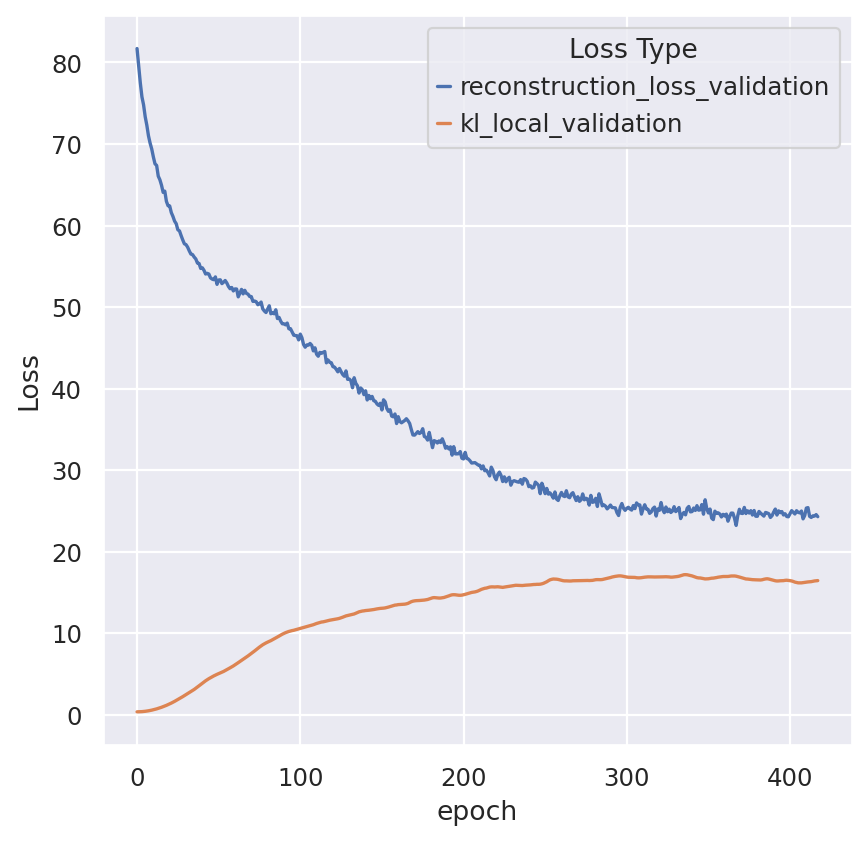

In [18]:
EPOCHS = 10000
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=50, batch_size=2000,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=400))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, prior_mixture=False)
model_cls = CytoVI
model_cls.setup_anndata(adata, layer='dsb', batch_key='sample',)
model = model_cls(adata, **model_kwargs)
model.train(**train_kwargs)
ax = plot_validation_loss(model, semilogy=False)

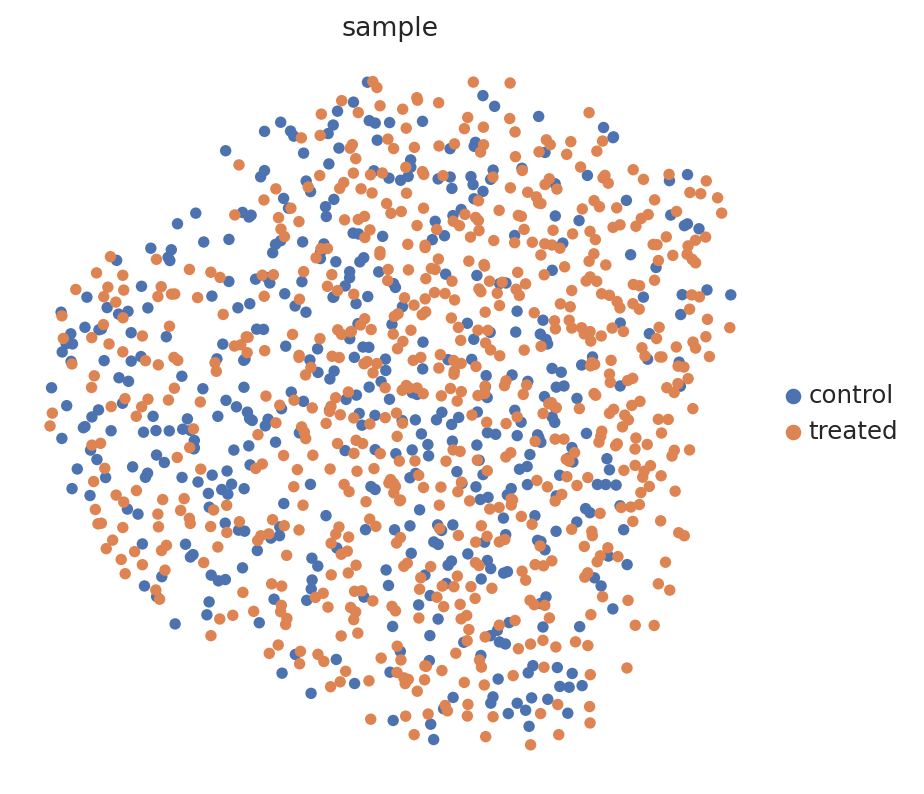

In [19]:
adata.obsm['model_latent'] = model.get_latent_representation()
sc.pp.neighbors(adata, use_rep='model_latent', key_added='model_latent')
sc.tl.umap(adata, neighbors_key='model_latent')
sc.pl.umap(adata, layer='dsb', color=['sample'])

In [25]:
adata.layers['model_decoded'] = model.get_normalized_expression()
sc.tl.rank_genes_groups(adata, groupby='sample', layer='model_decoded', use_raw=False, method='wilcoxon')
decoded_abundance_de = sc.get.rank_genes_groups_df(adata, group=None, pval_cutoff=0.05, log2fc_min=1)
decoded_abundance_de

,group,names,scores,logfoldchanges,pvals,pvals_adj


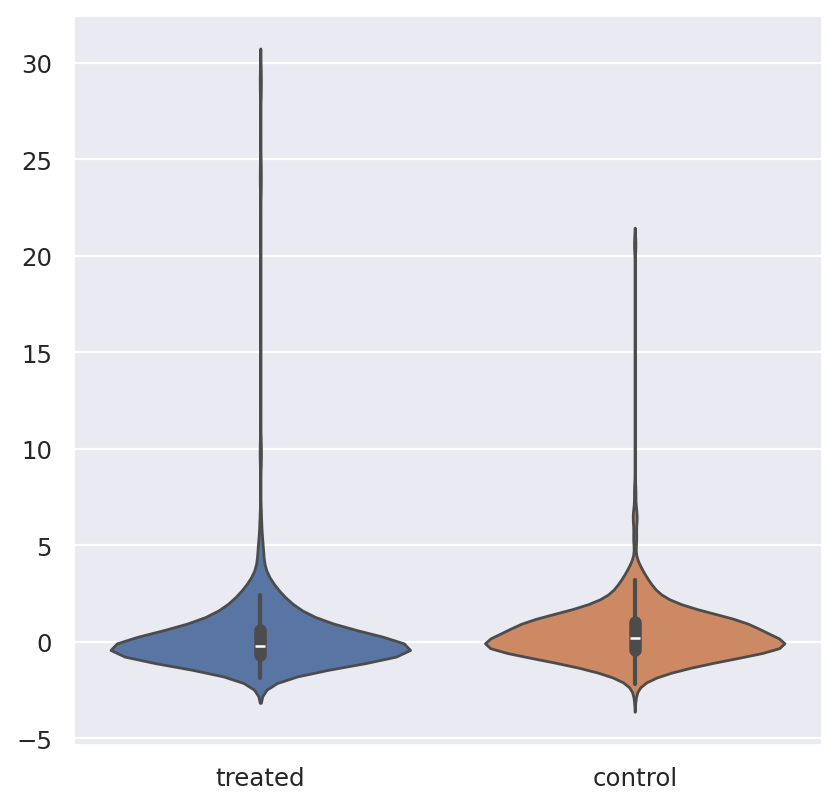

In [42]:
control_pol = pg_data.polarization[pg_data.polarization['sample'] == 'control']
treated_pol = pg_data.polarization[pg_data.polarization['sample'] == 'treated']
ax = sns.violinplot({'treated': treated_pol[treated_pol['marker'] == 'CD20']['morans_z'], 'control': control_pol[control_pol['marker'] == 'CD20']['morans_z']})


In [33]:
polarization = convert_polarization_to_feature_matrix(pg_data.polarization, components=adata.obs.index, key='morans_z', fill_na_with_mean=True)
# polarization = center_feature_matrix(polarization)
# polarization = np.log1p(polarization)
polarization.head(5)

,ACTB_pol,B2M_pol,CD102_pol,CD11a_pol,CD11b_pol,CD11c_pol,CD127_pol,CD137_pol,CD14_pol,CD150_pol,...,CD84_pol,CD86_pol,CD9_pol,HLA-ABC_pol,HLA-DR_pol,Rituximab_pol,TCRVb5_pol,mIgG1_pol,mIgG2a_pol,mIgG2b_pol
component,,,,,,,,,,,,,,,,,,,,,
RCVCMP0000000_treated,-0.723318,1.364380,0.106141,2.592735,0.287299,-0.307552,-0.229781,-0.317992,0.380556,-0.897200,...,3.089267,-0.015386,-0.458820,3.787975,-2.361723,16.170077,0.123326,0.138594,2.114201,0.224971
RCVCMP0000001_control,-0.451024,1.201509,1.259580,1.761256,-0.288351,-0.542682,1.279339,0.230023,-0.345139,0.089343,...,0.219712,-0.047881,-0.324693,2.391027,2.017028,33.740262,-0.135799,-0.240858,-0.073689,-0.117321
RCVCMP0000002_control,-0.610046,0.169949,2.213552,-0.525693,0.287299,0.036660,0.903472,0.230023,0.380556,-0.463951,...,-0.449948,1.021668,-1.111920,-0.249808,0.621811,33.740262,-0.568075,0.138594,-1.073876,0.224971
RCVCMP0000002_treated,-0.446889,-0.115703,0.393270,-0.714957,0.287299,-0.769966,-0.866357,0.230023,0.380556,-0.636780,...,-0.038051,-1.804562,0.269879,0.671582,-5.522206,58.012247,-0.048647,-0.239386,-0.465214,0.224971
RCVCMP0000003_control,0.352720,-0.721888,0.915489,-0.508639,0.287299,0.036660,3.685544,0.230023,0.332188,14.783454,...,2.104633,0.410235,-0.537668,-1.127177,-2.419325,33.740262,2.511289,0.138594,0.445163,-0.333226


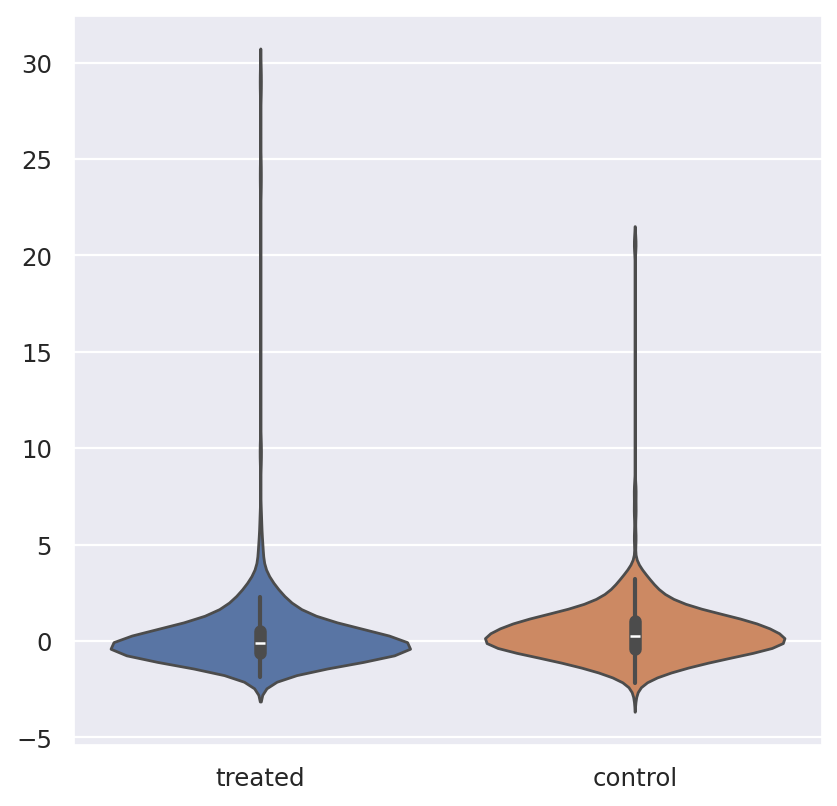

In [37]:
treated_comps = [c for c in polarization.index if 'treated' in c]
treated_pol = polarization[polarization.index.isin(treated_comps)]
control_pol = polarization[~polarization.index.isin(treated_comps)]
ax = sns.violinplot({'treated': treated_pol['CD20_pol'], 'control': control_pol['CD20_pol']})
# ax.set_ylim(-0.03, 0.03)
# sns.boxplot(control_pol['CD20_pol'], ax=ax, label='control')

In [269]:
joint_df = pd.concat((adata.to_df('dsb'), polarization), axis=1)
# joint_df = center_feature_matrix(joint_df) 
all_joint_adata = anndata.AnnData(
    X=joint_df,
    obs=adata.obs
)
components = adata.obs[adata.obs['sample'].isin(['control', 'treated'])].index
joint_adata = all_joint_adata[components, :].copy()
joint_adata.to_df()

,B2M,CD102,CD11a,CD11b,CD11c,CD127,CD137,CD14,CD150,CD152,...,CD84_pol,CD86_pol,CD9_pol,HLA-ABC_pol,HLA-DR_pol,Rituximab_pol,TCRVb5_pol,mIgG1_pol,mIgG2a_pol,mIgG2b_pol
component,,,,,,,,,,,,,,,,,,,,,
RCVCMP0000001_control,-0.111237,0.020757,0.590554,0.689846,0.976934,0.650733,0.433656,0.627862,1.039011,0.550274,...,0.173150,0.126289,-2.816220e-01,0.936001,0.916609,-3.496398e-16,-0.479680,-4.590472e-01,-0.337746,-3.767192e-01
RCVCMP0000002_control,0.093943,0.500458,1.268762,-0.199562,0.321596,0.773023,0.147258,0.733607,0.172127,1.079052,...,-0.598923,0.791504,-7.335876e-01,0.221043,0.716524,-3.496398e-16,-0.583277,-3.614267e-18,-1.014796,1.326919e-17
RCVCMP0000003_control,0.388971,0.752386,-1.940845,-0.062448,0.958235,-0.087922,-0.804261,1.510196,-0.124355,-0.555673,...,2.152715,0.223956,-3.454348e-01,-0.561155,-0.184291,-3.496398e-16,1.655916,-3.614267e-18,0.250258,-5.001553e-01
RCVCMP0000004_control,0.166520,0.160223,0.464360,0.666500,1.397868,0.878061,1.326983,0.454237,0.806964,0.935178,...,-0.099863,4.220202,5.456251e+00,0.011674,-0.439642,-3.496398e-16,-0.311291,-4.469719e-01,-0.402662,2.303378e-01
RCVCMP0000005_control,0.151118,-0.398879,0.697382,-0.147255,1.201521,0.524870,0.867014,0.429644,0.900988,0.793849,...,-0.225879,-0.256588,7.098121e-01,-0.599653,-0.020181,-3.496398e-16,0.096258,-3.614267e-18,-0.231550,1.354103e+00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
RCVCMP0001270_treated,0.288102,0.125846,0.916794,-0.671674,0.524413,1.026907,-0.021086,0.814821,0.160985,0.975725,...,-0.470577,0.682532,-7.273977e-18,1.040187,1.175659,1.800521e+00,-0.421984,-3.614267e-18,1.061501,1.326919e-17
RCVCMP0001290_treated,-0.343100,0.269721,-0.622463,-0.490401,1.894717,-0.549201,-0.519769,0.371281,-0.402938,0.308325,...,-0.014713,-0.713908,-7.273977e-18,-0.377166,-0.624159,2.280566e-01,-0.125044,-3.614267e-18,-0.150921,1.326919e-17
RCVCMP0001308_treated,0.196324,-0.388925,1.223397,-0.809393,0.398046,0.558188,0.747464,0.337506,-0.208454,0.267599,...,0.573217,-0.108613,-7.273977e-18,1.309319,-0.149703,-7.717912e-01,-1.685111,-3.614267e-18,0.957080,1.326919e-17


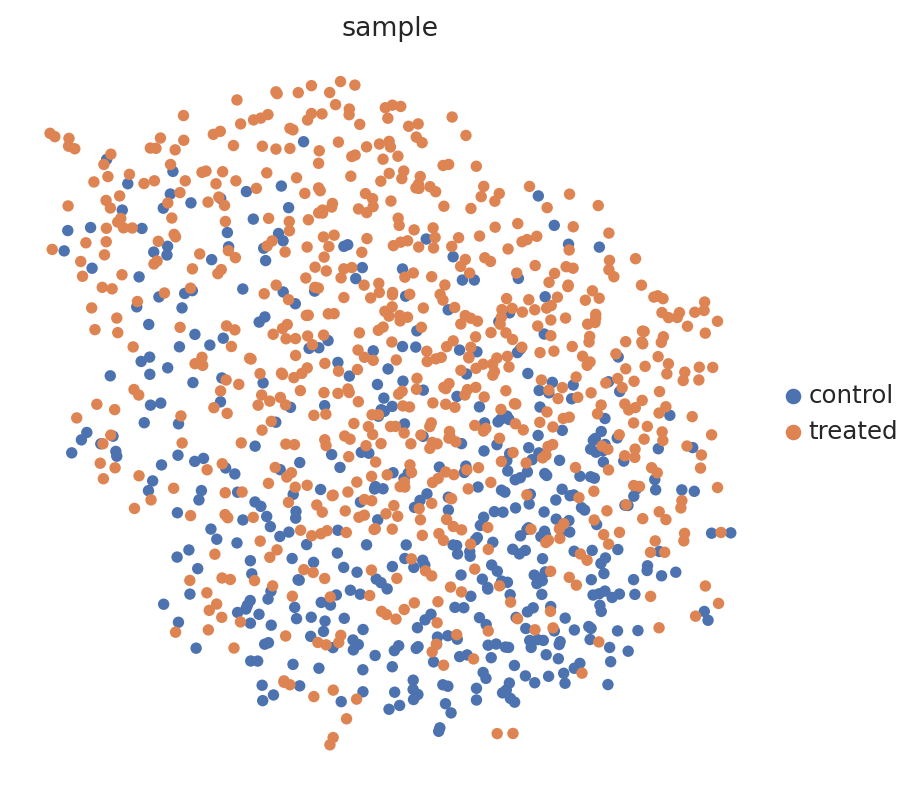

In [270]:
sc.pp.pca(joint_adata)
sc.pp.neighbors(joint_adata)
sc.tl.umap(joint_adata)
sc.pl.umap(joint_adata, color=['sample'])

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/labs/nyosef/eitangr/miniconda3/envs/pixelgen-scvi-1/lib/python3.10/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training:   0%|          | 0/10000 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 50 records. Best score: 146.651. Signaling Trainer to stop.


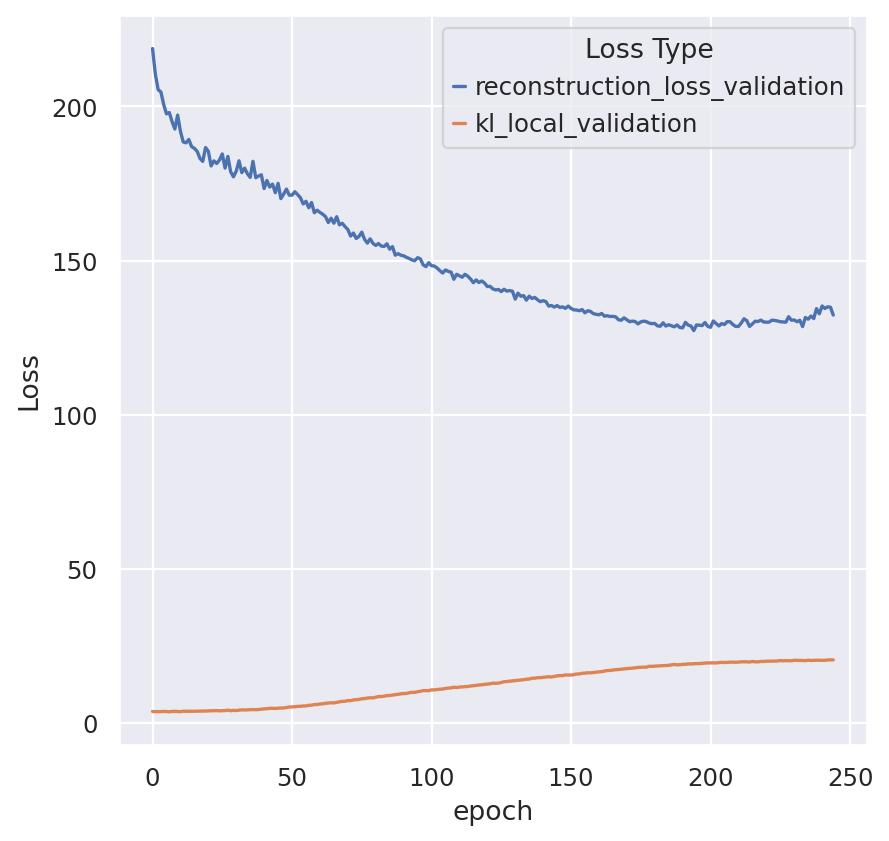

In [273]:
EPOCHS = 10000
train_kwargs = dict(train_size=0.8, check_val_every_n_epoch=1, early_stopping=True, early_stopping_patience=50, batch_size=2000,
                    max_epochs=EPOCHS, enable_checkpointing=True, plan_kwargs=dict(lr=3e-4, optimizer='Adam', n_epochs_kl_warmup=0))
model_kwargs = dict(n_latent=20, n_hidden=128, n_layers=1, dropout_rate=0.1, prior_mixture=True)
model_cls.setup_anndata(joint_adata, batch_key='sample',)
joint_model = model_cls(joint_adata, **model_kwargs)
joint_model.train(**train_kwargs)
ax = plot_validation_loss(joint_model, semilogy=False)

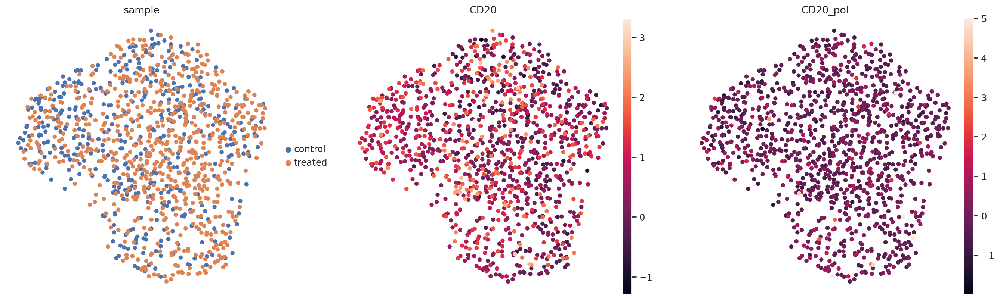

In [276]:
joint_adata.obsm['model_latent'] = joint_model.get_latent_representation()
sc.pp.neighbors(joint_adata, use_rep='model_latent', key_added='model_latent')
sc.tl.umap(joint_adata, neighbors_key='model_latent')
sc.pl.umap(joint_adata, color=['sample', 'CD20', 'CD20_pol'], vmax=[None, None, 5])

In [137]:
joint_de = joint_model.differential_expression(groupby='sample')
joint_de.sort_values(by='proba_not_de')

/tmp/ipykernel_2009889/1396647395.py:1: UserWarning: Protein expression exceeds clipping range, which can lead to poor DE results. Please adjust clipping range to data range.
  joint_de = joint_model.differential_expression(groupby='sample')


DE...:   0%|          | 0/2 [00:00<?, ?it/s]

,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,lfc_min,lfc_max,is_de_fdr_0.05,comparison,group1,group2
CD37_pol,0.9660,0.0340,3.346803,0.047805,0.010583,0.0,0.25,4.702180,2.535788,5.803097,-16.646248,16.817127,True,imm_rantes vs Rest,imm_rantes,Rest
CD37_pol,0.9598,0.0402,3.172858,0.009909,0.046926,0.0,0.25,-4.876430,-2.523261,5.794807,-16.775187,17.004429,True,sol_rantes vs Rest,sol_rantes,Rest
CD50_pol,0.9598,0.0402,3.172858,0.011955,0.061604,0.0,0.25,-5.954415,-3.610995,6.397195,-17.360035,16.490351,True,sol_rantes vs Rest,sol_rantes,Rest
CD50_pol,0.9546,0.0454,3.045780,0.063819,0.012425,0.0,0.25,5.919132,3.653688,6.191442,-16.654804,17.383856,True,imm_rantes vs Rest,imm_rantes,Rest
CD44_pol,0.9438,0.0562,2.820997,0.052304,0.013866,0.0,0.25,4.521864,2.383278,6.673743,-16.792437,17.578165,True,imm_rantes vs Rest,imm_rantes,Rest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CD244_pol,0.4110,0.5890,-0.359833,-0.004325,-0.003466,0.0,0.25,-0.928986,0.000000,7.363546,-15.195055,15.267601,False,sol_rantes vs Rest,sol_rantes,Rest
CD11b,0.2664,0.7336,-1.012965,1.110749,1.174477,0.0,0.25,0.048749,0.000000,0.295292,-1.248465,1.858503,False,sol_rantes vs Rest,sol_rantes,Rest
CD11b,0.2630,0.7370,-1.030434,1.185561,1.108675,0.0,0.25,-0.042900,0.000000,0.287641,-1.970356,1.467408,False,imm_rantes vs Rest,imm_rantes,Rest
CD26,0.0040,0.9960,-5.517450,2.817309,2.601563,0.0,0.25,0.001548,0.000000,0.025756,-0.263065,0.604493,False,imm_rantes vs Rest,imm_rantes,Rest


In [ ]:
components_to_keep = pg_data_combined_pxl_object.adata[
    (pg_data_combined_pxl_object.adata.obs["molecules"] >= 10000)
    & (pg_data_combined_pxl_object.adata.obs["tau_type"] == "normal")
].obs.index

pg_data_combined_pxl_object.filter(components=components_to_keep).save(DATA_DIR/ "combined_data_filtered.pxl", force_overwrite=True)